<a href="https://colab.research.google.com/github/TmKarter/GAN_education/blob/master/adv_gan_example.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import torch
import torch.nn as nn
from torch.nn.functional import leaky_relu, relu, dropout

import os, time
import torch.optim as optim
from torchvision import transforms

In [ ]:
class generator(nn.Module):
    # initializers
    def __init__(self):
        super(generator, self).__init__()
        
        # блок слоев энкодера
        self.enc_conv1 = nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1)
        self.enc_conv2 = nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1)
        self.el2_bn = nn.BatchNorm2d(128)
        self.enc_conv3 = nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1)
        self.el3_bn = nn.BatchNorm2d(256)
        self.enc_conv4 = nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1)
        self.el4_bn = nn.BatchNorm2d(512)
        self.enc_conv5 = nn.Conv2d(512, 512, kernel_size=4, stride=2, padding=1)
        self.el5_bn = nn.BatchNorm2d(512)
        self.enc_conv6 = nn.Conv2d(512, 512, kernel_size=4, stride=2, padding=1)
        self.el6_bn = nn.BatchNorm2d(512)
        self.enc_conv7 = nn.Conv2d(512, 512, kernel_size=4, stride=2, padding=1)
        self.el7_bn = nn.BatchNorm2d(512)
        self.enc_conv8 = nn.Conv2d(512, 512, kernel_size=4, stride=2, padding=1)
        self.el8_bn = nn.BatchNorm2d(512)

        # блок слоев декодера
        self.de_conv1 = nn.ConvTranspose2d(512, 512, kernel_size=4, stride=2, padding=1)
        self.dl1_bn = nn.BatchNorm2d(512)
        self.de_conv2 = nn.ConvTranspose2d(1024, 512, kernel_size=4, stride=2, padding=1)
        self.dl2_bn = nn.BatchNorm2d(512)
        self.de_conv3 = nn.ConvTranspose2d(1024, 512, kernel_size=4, stride=2, padding=1)
        self.dl3_bn = nn.BatchNorm2d(512)
        self.de_conv4 = nn.ConvTranspose2d(1024, 512, kernel_size=4, stride=2, padding=1)
        self.dl4_bn = nn.BatchNorm2d(512)
        self.de_conv5 = nn.ConvTranspose2d(1024, 256, kernel_size=4, stride=2, padding=1)
        self.dl5_bn = nn.BatchNorm2d(256)
        self.de_conv6 = nn.ConvTranspose2d(512, 128, kernel_size=4, stride=2, padding=1)
        self.dl6_bn = nn.BatchNorm2d(128)
        self.de_conv7 = nn.ConvTranspose2d(256, 64, kernel_size=4, stride=2, padding=1)
        self.dl7_bn = nn.BatchNorm2d(64)
        self.de_conv8 = nn.ConvTranspose2d(128, 3, kernel_size=4, stride=2, padding=1)

    # # weight_init
    def weight_init(self, mean, std):
        for m in self._modules:
            normal_init(self._modules[m], mean, std)

    # forward method
    def forward(self, input):
        e1 = self.enc_conv1(input)
        e2 = self.el2_bn(self.enc_conv2(leaky_relu(e1, 0.2)))
        e3 = self.el3_bn(self.enc_conv3(leaky_relu(e2, 0.2)))
        e4 = self.el4_bn(self.enc_conv4(leaky_relu(e3, 0.2)))
        e5 = self.el5_bn(self.enc_conv5(leaky_relu(e4, 0.2)))
        e6 = self.el6_bn(self.enc_conv6(leaky_relu(e5, 0.2)))
        e7 = self.el7_bn(self.enc_conv7(leaky_relu(e6, 0.2)))
        e8 = self.el8_bn(self.enc_conv8(leaky_relu(e7, 0.2)))

        d1 = dropout(self.dl1_bn(self.de_conv1(relu(e8))), 0.5, training=True)
        d1 = torch.cat([d1, e7], 1)
        d2 = dropout(self.dl2_bn(self.de_conv2(relu(d1))), 0.5, training=True)
        d2 = torch.cat([d2, e6], 1)
        d3 = dropout(self.dl3_bn(self.de_conv3(relu(d2))), 0.5, training=True)
        d3 = torch.cat([d3, e5], 1)
        d4 = self.dl4_bn(self.de_conv4(relu(d3)))
        d4 = torch.cat([d4, e4], 1)
        d5 = self.dl5_bn(self.de_conv5(relu(d4)))
        d5 = torch.cat([d5, e3], 1)
        d6 = self.dl6_bn(self.de_conv6(relu(d5)))
        d6 = torch.cat([d6, e2], 1)
        d7 = self.dl7_bn(self.de_conv7(relu(d6)))
        d7 = torch.cat([d7, e1], 1)
        d8 = self.de_conv8(relu(d7))
        out = torch.tanh(d8)

        return out

class discriminator(nn.Module):
    # initializers
    def __init__(self):
        super(discriminator, self).__init__()
        self.conv1 = nn.Conv2d(6, 64, kernel_size=4, stride=2, padding=1)
        self.conv2 = nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1)
        self.l2_bn = nn.BatchNorm2d(128)
        self.conv3 = nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1)
        self.l3_bn = nn.BatchNorm2d(256)
        self.conv4 = nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1) # stride == 1?
        self.l4_bn = nn.BatchNorm2d(512)
        self.conv5 = nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=1)

    # weight_init
    def weight_init(self, mean, std):
        for m in self._modules:
            normal_init(self._modules[m], mean, std)

    # forward method
    def forward(self, input, label):
        x = torch.cat([input, label], 1)
        x = leaky_relu(self.conv1(x), 0.2)
        x = leaky_relu(self.l2_bn(self.conv2(x)), 0.2)
        x = leaky_relu(self.l3_bn(self.conv3(x)), 0.2)
        x = leaky_relu(self.l4_bn(self.conv4(x)), 0.2)
        out = torch.sigmoid(self.conv5(x))

        return out

def normal_init(m, mean, std):
    if isinstance(m, nn.ConvTranspose2d) or isinstance(m, nn.Conv2d):
        m.weight.data.normal_(mean, std)
        m.bias.data.zero_()

In [ ]:
import subprocess
import tarfile


bashCommand = "wget https://people.eecs.berkeley.edu/~tinghuiz/projects/pix2pix/datasets/facades.tar.gz"
process = subprocess.Popen(bashCommand.split(), stdout=subprocess.PIPE)
process.wait()

0

In [ ]:
fname = 'facades.tar.gz'
tar = tarfile.open(fname, "r:gz")
tar.extractall()
tar.close()

In [ ]:
from torch.utils import data
from os.path import join

# data_loader
my_transform = transforms.Compose([
        transforms.Resize(256),                        
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

BATCH_SIZE = 4
VAL_BATCH_SIZE=4
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

class Castom_Dataset(data.Dataset):
    def __init__(self, data_root, mode, transform):
        self.root_dir = join(data_root, mode)
        list_paths = []
        for item in os.listdir(self.root_dir):
            list_paths.append(join(self.root_dir, item))
        
        self.data = sorted(list_paths)
        self.transformation = transform

    def __getitem__(self, ind):
        cur_image = Image.open(self.data[ind]).convert('RGB')

        image_1 = self.transformation(
            cur_image.crop(box=(0, 0, int(cur_image.size[0] / 2), cur_image.size[1])))
        
        image_2 = self.transformation(
            cur_image.crop((int(cur_image.size[0] / 2), 0, cur_image.size[0], cur_image.size[1])))
        
        return image_2, image_1 # у фасадов лейблы в другом порядке

    def __len__(self):
        return len(self.data)

data_set_train = Castom_Dataset("facades", "train", my_transform)
data_set_val = Castom_Dataset("facades", "val", my_transform)
loader_val = data.DataLoader(data_set_val, batch_size=VAL_BATCH_SIZE, shuffle=False)
loader_train = data.DataLoader(data_set_train, batch_size=BATCH_SIZE, shuffle=True)

In [ ]:
# network
G = generator()
D = discriminator()
G.weight_init(mean=0.0, std=0.02)
D.weight_init(mean=0.0, std=0.02)
G.cuda()
D.cuda()
G.train()
D.train()

# loss
BCE_loss = nn.BCELoss().cuda()
L1_loss = nn.L1Loss().cuda()

# Adam optimizer
G_optimizer = optim.Adam(G.parameters(), lr=0.0001, betas=(0.5, 0.999))
D_optimizer = optim.Adam(D.parameters(), lr=0.0001, betas=(0.5, 0.999))

In [ ]:
train_hist = {'D_loss': [], 'D_l_fake': [], 'D_l_real': [],
              'G_loss': [], 'G_l_l1':[]}

val_hist = {'D_loss': [], 'D_l_fake': [], 'D_l_real': [],
              'G_loss': [], 'G_l_l1':[]}

In [ ]:
from tqdm.auto import tqdm
from PIL import Image
from IPython.display import clear_output

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

def show_result(G, loader_val, epoch_cur):
    outlines = []
    target = []
    predict = []

    G.eval()
    batch_1, batch_2 = next(iter(loader_val))

    fake_2 = G(batch_1[:5,:,:,:].cuda())
    outlines = batch_1
    target = batch_2[:5,:,:,:]
    predict = fake_2.cpu()

    #clear_output(wait = True)
    for i in range(predict.shape[0]):
        concat_image = (torch.cat([outlines[i], predict[i], target[i]], dim=-1) + 1.) / 2.
        plt.imshow(np.transpose(concat_image.detach().numpy(), (1,2,0)))
        # plt.savefig('./res_pic/' +'num' + str(i) + '_epoch_' + str(epoch_cur) + '.png')
        plt.show()


[0/500] - loss_d: 0.309, loss_g: 82.382


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


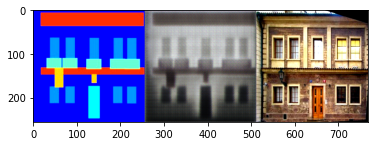

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


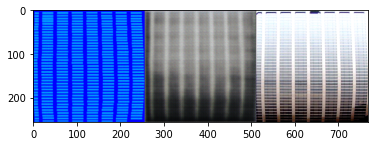

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


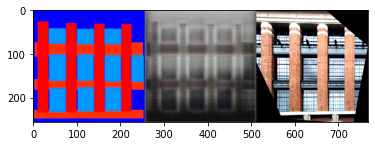

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


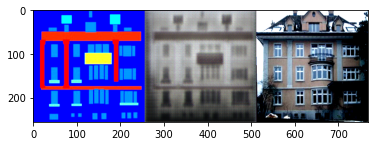


[1/500] - loss_d: 0.040, loss_g: 80.891



[2/500] - loss_d: 0.034, loss_g: 79.706



[3/500] - loss_d: 0.029, loss_g: 79.058



[4/500] - loss_d: 0.038, loss_g: 77.039



[5/500] - loss_d: 0.082, loss_g: 74.942



[6/500] - loss_d: 0.007, loss_g: 74.251



[7/500] - loss_d: 0.006, loss_g: 72.979



[8/500] - loss_d: 0.050, loss_g: 70.950



[9/500] - loss_d: 0.040, loss_g: 69.791



[10/500] - loss_d: 0.007, loss_g: 69.619


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


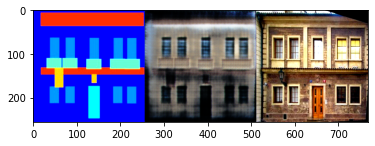

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


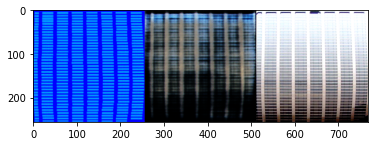

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


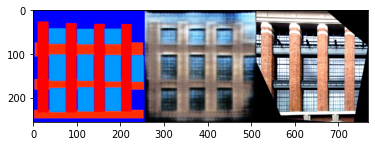

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


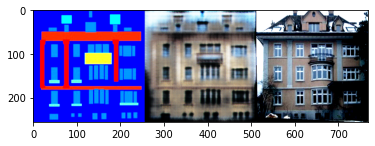


[11/500] - loss_d: 0.003, loss_g: 68.537



[12/500] - loss_d: 0.003, loss_g: 67.030



[13/500] - loss_d: 0.002, loss_g: 66.301



[14/500] - loss_d: 0.056, loss_g: 64.880



[15/500] - loss_d: 0.051, loss_g: 63.452



[16/500] - loss_d: 0.004, loss_g: 63.194



[17/500] - loss_d: 0.003, loss_g: 62.965



[18/500] - loss_d: 0.006, loss_g: 62.079



[19/500] - loss_d: 0.002, loss_g: 61.688



[20/500] - loss_d: 0.001, loss_g: 61.389


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


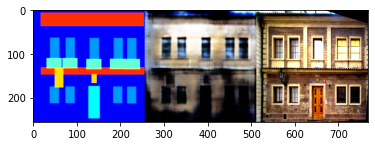

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


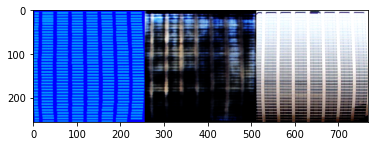

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


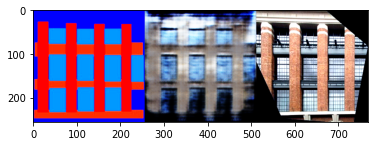

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


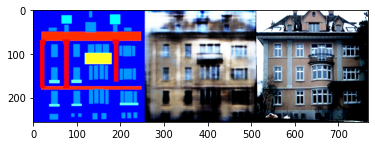


[21/500] - loss_d: 0.002, loss_g: 60.793



[22/500] - loss_d: 0.001, loss_g: 60.501



[23/500] - loss_d: 0.001, loss_g: 60.000



[24/500] - loss_d: 0.040, loss_g: 58.402



[25/500] - loss_d: 0.003, loss_g: 58.240



[26/500] - loss_d: 0.008, loss_g: 57.479



[27/500] - loss_d: 0.099, loss_g: 56.472



[28/500] - loss_d: 0.004, loss_g: 56.141



[29/500] - loss_d: 0.002, loss_g: 55.841



[30/500] - loss_d: 0.002, loss_g: 55.862


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


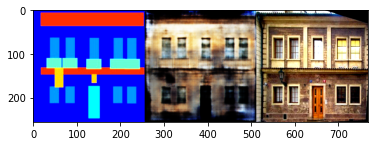

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


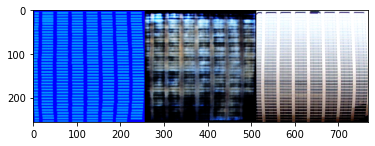

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


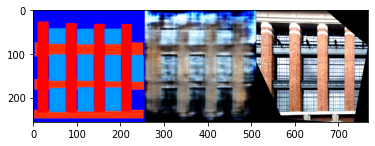

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


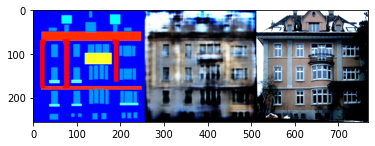


[31/500] - loss_d: 0.012, loss_g: 55.372



[32/500] - loss_d: 0.005, loss_g: 54.867



[33/500] - loss_d: 0.001, loss_g: 55.552



[34/500] - loss_d: 0.001, loss_g: 54.920



[35/500] - loss_d: 0.000, loss_g: 54.972



[36/500] - loss_d: 0.001, loss_g: 54.284



[37/500] - loss_d: 0.001, loss_g: 54.241



[38/500] - loss_d: 0.106, loss_g: 52.874



[39/500] - loss_d: 0.005, loss_g: 52.535



[40/500] - loss_d: 0.002, loss_g: 52.928


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


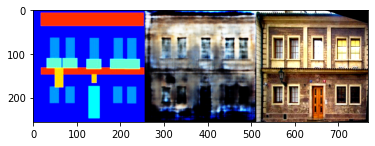

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


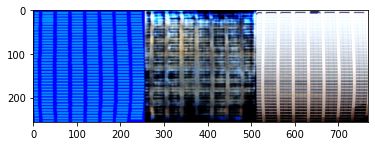

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


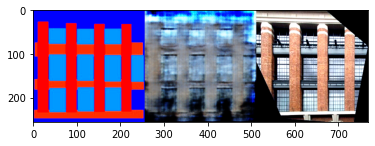

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


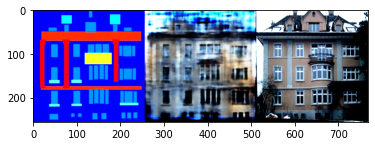


[41/500] - loss_d: 0.001, loss_g: 52.907



[42/500] - loss_d: 0.003, loss_g: 52.384



[43/500] - loss_d: 0.001, loss_g: 52.513



[44/500] - loss_d: 0.000, loss_g: 52.293



[45/500] - loss_d: 0.000, loss_g: 52.388



[46/500] - loss_d: 0.000, loss_g: 52.233



[47/500] - loss_d: 0.000, loss_g: 52.257



[48/500] - loss_d: 0.000, loss_g: 51.977



[49/500] - loss_d: 0.002, loss_g: 51.609



[50/500] - loss_d: 0.001, loss_g: 51.388


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


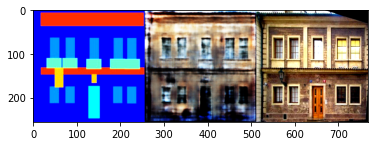

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


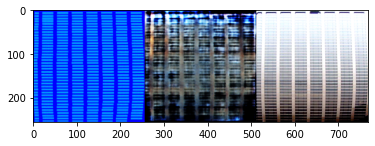

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


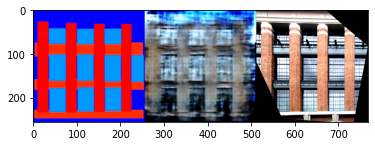

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


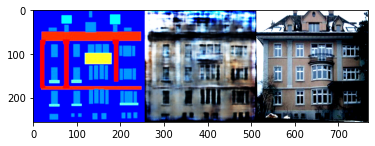


[51/500] - loss_d: 0.003, loss_g: 51.540



[52/500] - loss_d: 0.001, loss_g: 51.515



[53/500] - loss_d: 0.001, loss_g: 51.130



[54/500] - loss_d: 0.000, loss_g: 51.312



[55/500] - loss_d: 0.001, loss_g: 50.519



[56/500] - loss_d: 0.000, loss_g: 50.540



[57/500] - loss_d: 0.000, loss_g: 50.807



[58/500] - loss_d: 0.000, loss_g: 50.908



[59/500] - loss_d: 0.000, loss_g: 50.986



[60/500] - loss_d: 0.000, loss_g: 50.517


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


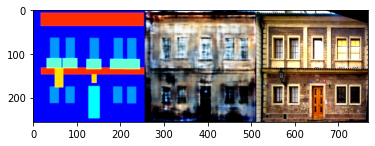

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


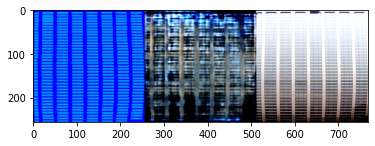

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


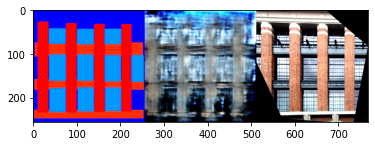

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


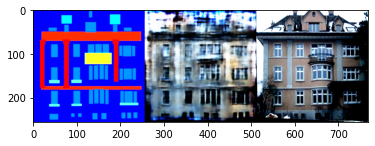


[61/500] - loss_d: 0.000, loss_g: 50.735



[62/500] - loss_d: 0.000, loss_g: 50.657



[63/500] - loss_d: 0.000, loss_g: 50.492



[64/500] - loss_d: 0.000, loss_g: 49.971



[65/500] - loss_d: 0.000, loss_g: 49.898



[66/500] - loss_d: 0.000, loss_g: 49.974



[67/500] - loss_d: 0.000, loss_g: 50.152



[68/500] - loss_d: 0.000, loss_g: 50.111



[69/500] - loss_d: 0.175, loss_g: 47.910



[70/500] - loss_d: 0.005, loss_g: 46.771


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


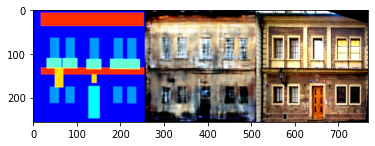

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


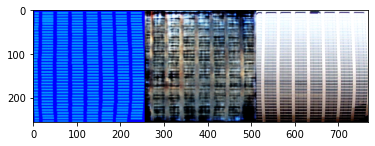

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


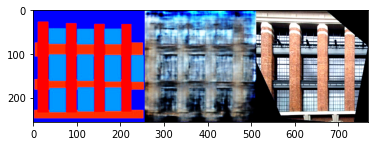

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


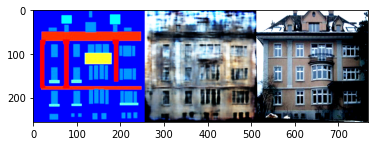


[71/500] - loss_d: 0.005, loss_g: 47.290



[72/500] - loss_d: 0.087, loss_g: 46.728



[73/500] - loss_d: 0.005, loss_g: 46.399



[74/500] - loss_d: 0.001, loss_g: 46.762



[75/500] - loss_d: 0.001, loss_g: 46.753



[76/500] - loss_d: 0.025, loss_g: 46.125



[77/500] - loss_d: 0.005, loss_g: 46.289



[78/500] - loss_d: 0.001, loss_g: 46.651



[79/500] - loss_d: 0.003, loss_g: 46.290



[80/500] - loss_d: 0.001, loss_g: 46.536


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


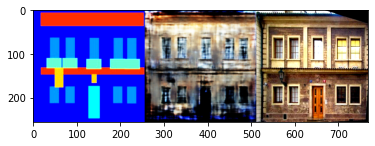

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


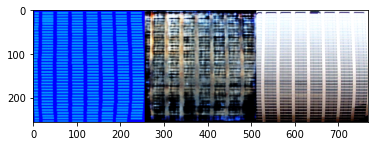

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


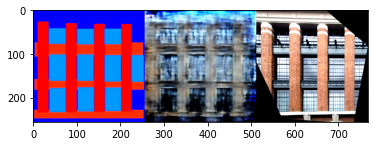

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


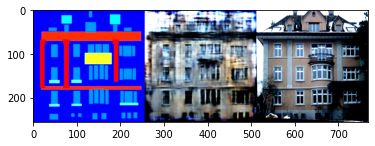


[81/500] - loss_d: 0.001, loss_g: 46.488



[82/500] - loss_d: 0.000, loss_g: 46.766



[83/500] - loss_d: 0.000, loss_g: 46.808



[84/500] - loss_d: 0.001, loss_g: 46.547



[85/500] - loss_d: 0.001, loss_g: 46.610



[86/500] - loss_d: 0.000, loss_g: 46.824



[87/500] - loss_d: 0.000, loss_g: 47.006



[88/500] - loss_d: 0.000, loss_g: 46.558



[89/500] - loss_d: 0.000, loss_g: 46.868



[90/500] - loss_d: 0.000, loss_g: 46.862


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


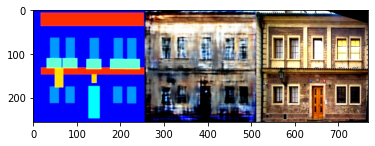

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


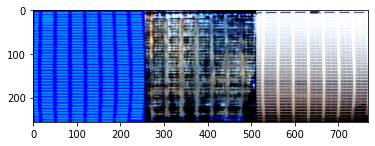

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


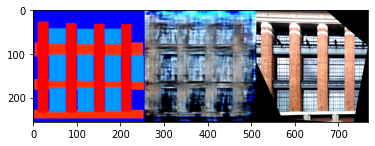

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


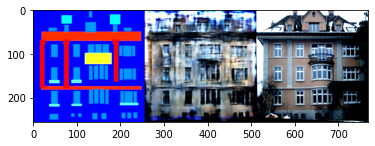


[91/500] - loss_d: 0.000, loss_g: 46.941



[92/500] - loss_d: 0.000, loss_g: 46.512



[93/500] - loss_d: 0.000, loss_g: 46.706



[94/500] - loss_d: 0.000, loss_g: 46.716



[95/500] - loss_d: 0.130, loss_g: 46.138



[96/500] - loss_d: 0.003, loss_g: 45.287



[97/500] - loss_d: 0.002, loss_g: 44.974



[98/500] - loss_d: 0.002, loss_g: 45.095



[99/500] - loss_d: 0.089, loss_g: 44.509



[100/500] - loss_d: 0.011, loss_g: 45.418


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


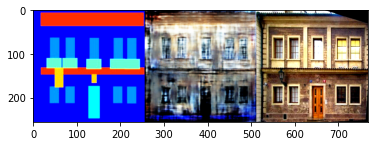

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


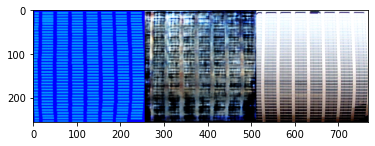

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


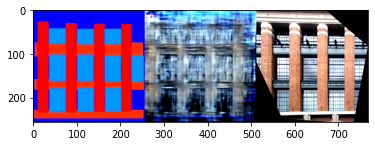

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


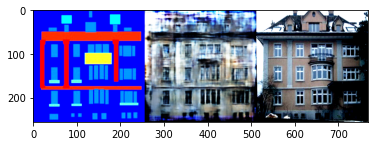


[101/500] - loss_d: 0.023, loss_g: 44.384



[102/500] - loss_d: 0.082, loss_g: 43.702



[103/500] - loss_d: 0.002, loss_g: 43.942



[104/500] - loss_d: 0.001, loss_g: 44.216



[105/500] - loss_d: 0.001, loss_g: 44.135



[106/500] - loss_d: 0.001, loss_g: 44.183



[107/500] - loss_d: 0.001, loss_g: 44.400



[108/500] - loss_d: 0.001, loss_g: 44.592



[109/500] - loss_d: 0.000, loss_g: 44.947



[110/500] - loss_d: 0.000, loss_g: 44.786


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


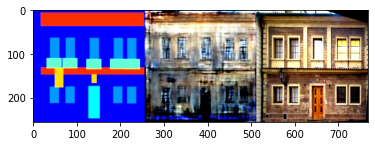

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


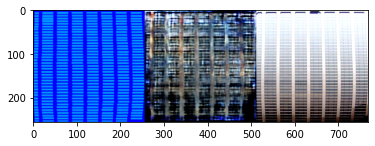

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


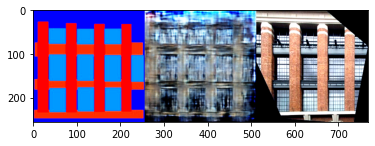

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


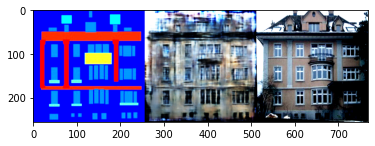


[111/500] - loss_d: 0.000, loss_g: 44.878



[112/500] - loss_d: 0.000, loss_g: 44.601



[113/500] - loss_d: 0.000, loss_g: 44.719



[114/500] - loss_d: 0.026, loss_g: 44.233



[115/500] - loss_d: 0.001, loss_g: 44.101



[116/500] - loss_d: 0.002, loss_g: 44.251



[117/500] - loss_d: 0.000, loss_g: 44.352



[118/500] - loss_d: 0.000, loss_g: 44.629



[119/500] - loss_d: 0.000, loss_g: 44.770



[120/500] - loss_d: 0.000, loss_g: 44.733


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


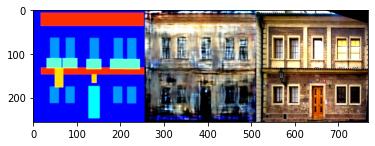

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


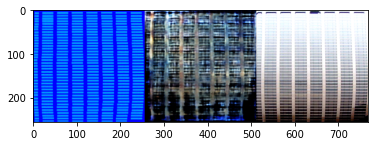

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


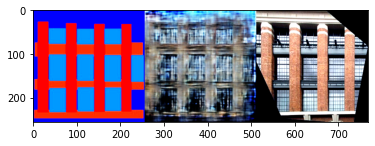

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


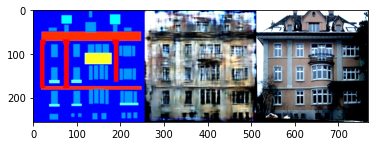


[121/500] - loss_d: 0.000, loss_g: 44.453



[122/500] - loss_d: 0.000, loss_g: 44.670



[123/500] - loss_d: 0.000, loss_g: 44.773



[124/500] - loss_d: 0.000, loss_g: 45.034



[125/500] - loss_d: 0.000, loss_g: 44.953



[126/500] - loss_d: 0.000, loss_g: 44.932



[127/500] - loss_d: 0.000, loss_g: 44.822



[128/500] - loss_d: 0.000, loss_g: 44.548



[129/500] - loss_d: 0.062, loss_g: 44.296



[130/500] - loss_d: 0.003, loss_g: 43.528


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


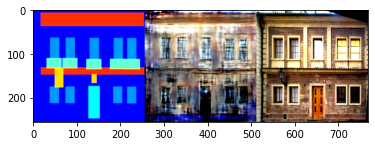

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


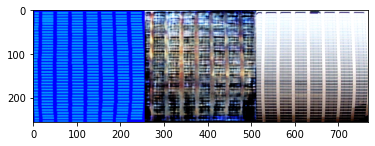

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


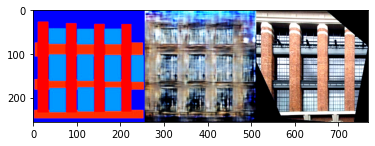

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


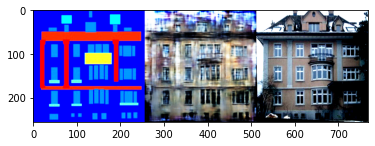


[131/500] - loss_d: 0.001, loss_g: 43.124



[132/500] - loss_d: 0.000, loss_g: 43.883



[133/500] - loss_d: 0.000, loss_g: 44.373



[134/500] - loss_d: 0.000, loss_g: 44.482



[135/500] - loss_d: 0.000, loss_g: 44.350



[136/500] - loss_d: 0.000, loss_g: 44.218



[137/500] - loss_d: 0.000, loss_g: 43.870



[138/500] - loss_d: 0.000, loss_g: 43.790



[139/500] - loss_d: 0.000, loss_g: 44.142



[140/500] - loss_d: 0.000, loss_g: 44.326


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


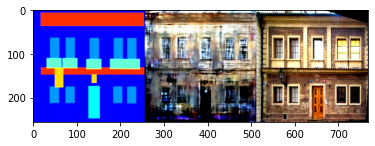

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


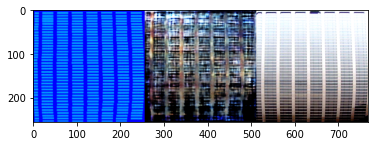

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


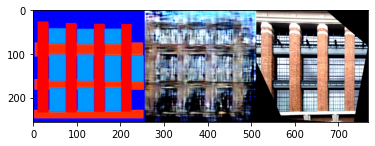

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


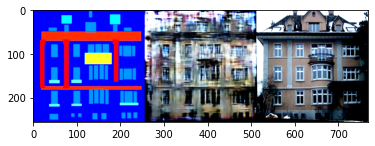


[141/500] - loss_d: 0.000, loss_g: 44.318



[142/500] - loss_d: 0.000, loss_g: 43.911



[143/500] - loss_d: 0.001, loss_g: 44.057



[144/500] - loss_d: 0.000, loss_g: 44.217



[145/500] - loss_d: 0.000, loss_g: 44.368



[146/500] - loss_d: 0.000, loss_g: 44.418



[147/500] - loss_d: 0.000, loss_g: 44.308



[148/500] - loss_d: 0.000, loss_g: 44.151



[149/500] - loss_d: 0.000, loss_g: 44.018



[150/500] - loss_d: 0.000, loss_g: 44.116


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


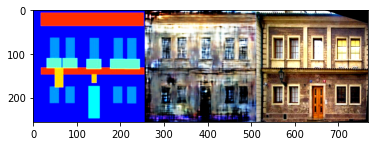

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


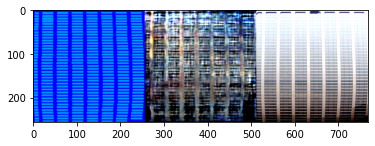

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


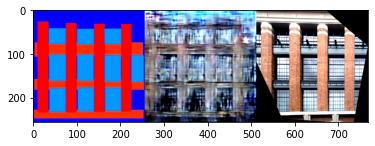

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


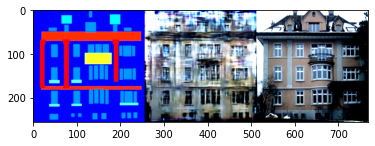


[151/500] - loss_d: 0.000, loss_g: 44.218



[152/500] - loss_d: 0.000, loss_g: 43.751



[153/500] - loss_d: 0.000, loss_g: 44.126



[154/500] - loss_d: 0.000, loss_g: 44.222



[155/500] - loss_d: 0.000, loss_g: 44.182



[156/500] - loss_d: 0.000, loss_g: 44.185



[157/500] - loss_d: 0.000, loss_g: 44.179



[158/500] - loss_d: 0.034, loss_g: 42.762



[159/500] - loss_d: 0.001, loss_g: 42.994



[160/500] - loss_d: 0.001, loss_g: 42.542


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


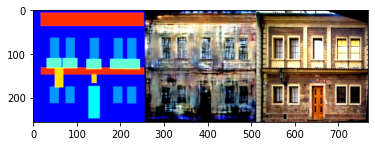

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


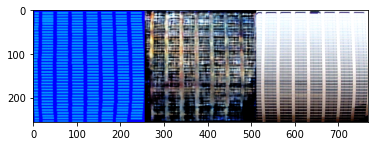

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


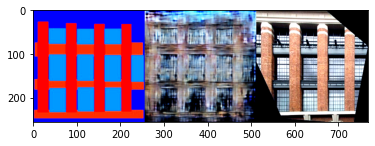

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


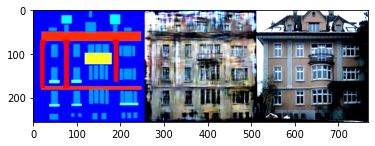


[161/500] - loss_d: 0.000, loss_g: 42.986



[162/500] - loss_d: 0.000, loss_g: 43.064



[163/500] - loss_d: 0.000, loss_g: 42.859



[164/500] - loss_d: 0.000, loss_g: 43.186



[165/500] - loss_d: 0.000, loss_g: 43.319



[166/500] - loss_d: 0.000, loss_g: 43.748



[167/500] - loss_d: 0.000, loss_g: 43.701



[168/500] - loss_d: 0.000, loss_g: 43.762



[169/500] - loss_d: 0.000, loss_g: 42.990



[170/500] - loss_d: 0.000, loss_g: 42.813


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


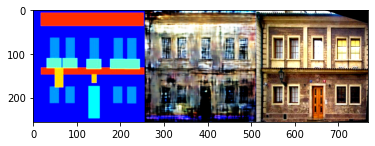

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


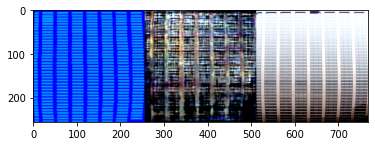

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


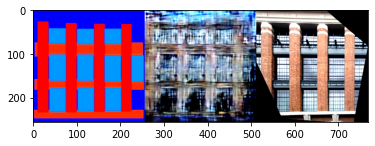

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


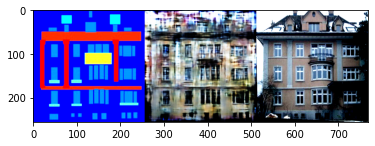


[171/500] - loss_d: 0.000, loss_g: 43.162



[172/500] - loss_d: 0.000, loss_g: 43.036



[173/500] - loss_d: 0.000, loss_g: 43.422



[174/500] - loss_d: 0.000, loss_g: 43.730



[175/500] - loss_d: 0.000, loss_g: 43.681



[176/500] - loss_d: 0.000, loss_g: 43.914



[177/500] - loss_d: 0.000, loss_g: 43.670



[178/500] - loss_d: 0.000, loss_g: 43.435



[179/500] - loss_d: 0.000, loss_g: 43.794



[180/500] - loss_d: 0.000, loss_g: 43.826


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


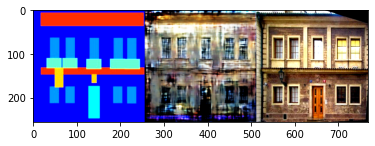

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


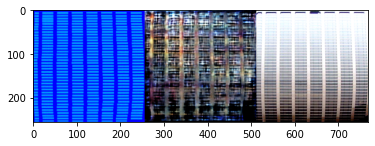

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


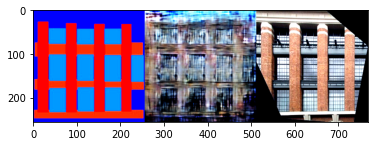

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


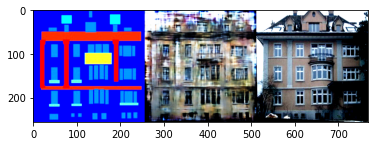


[181/500] - loss_d: 0.000, loss_g: 43.871



[182/500] - loss_d: 0.000, loss_g: 43.876



[183/500] - loss_d: 0.000, loss_g: 43.874



[184/500] - loss_d: 0.000, loss_g: 43.786



[185/500] - loss_d: 0.000, loss_g: 43.883



[186/500] - loss_d: 0.000, loss_g: 43.998



[187/500] - loss_d: 0.000, loss_g: 44.001



[188/500] - loss_d: 0.000, loss_g: 43.889



[189/500] - loss_d: 0.000, loss_g: 43.898



[190/500] - loss_d: 0.000, loss_g: 43.996


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


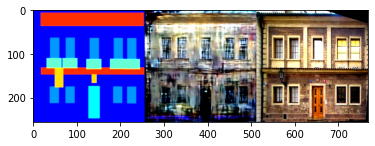

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


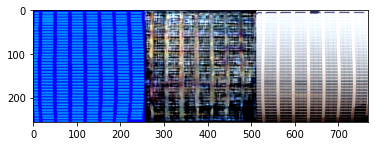

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


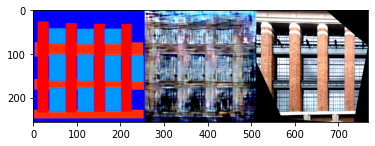

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


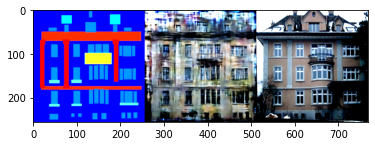


[191/500] - loss_d: 0.152, loss_g: 41.829



[192/500] - loss_d: 0.002, loss_g: 40.585



[193/500] - loss_d: 0.001, loss_g: 41.058



[194/500] - loss_d: 0.001, loss_g: 41.149



[195/500] - loss_d: 0.001, loss_g: 40.985



[196/500] - loss_d: 0.000, loss_g: 41.443



[197/500] - loss_d: 0.000, loss_g: 41.449



[198/500] - loss_d: 0.000, loss_g: 41.654



[199/500] - loss_d: 0.000, loss_g: 41.721



[200/500] - loss_d: 0.000, loss_g: 41.265


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


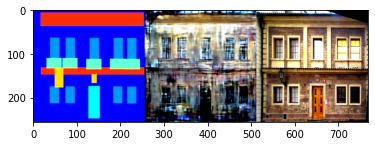

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


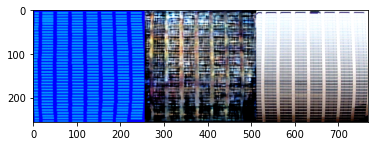

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


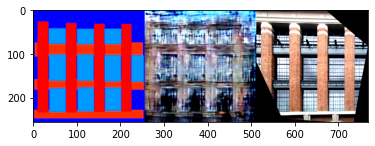

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


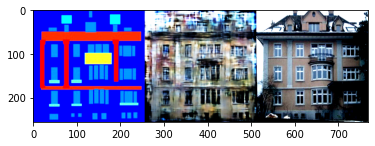


[201/500] - loss_d: 0.000, loss_g: 41.620



[202/500] - loss_d: 0.000, loss_g: 41.928



[203/500] - loss_d: 0.000, loss_g: 42.090



[204/500] - loss_d: 0.000, loss_g: 42.033



[205/500] - loss_d: 0.000, loss_g: 42.041



[206/500] - loss_d: 0.000, loss_g: 42.067



[207/500] - loss_d: 0.000, loss_g: 42.088



[208/500] - loss_d: 0.000, loss_g: 42.216



[209/500] - loss_d: 0.000, loss_g: 42.298



[210/500] - loss_d: 0.000, loss_g: 42.359


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


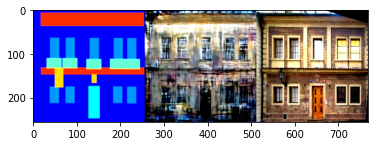

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


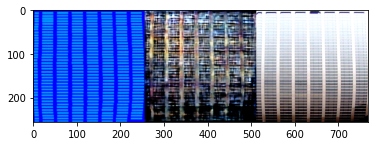

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


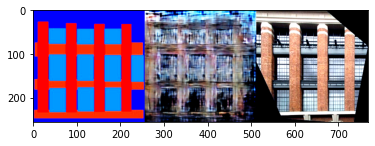

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


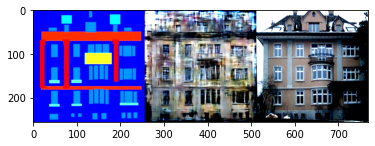


[211/500] - loss_d: 0.000, loss_g: 42.304



[212/500] - loss_d: 0.000, loss_g: 42.387



[213/500] - loss_d: 0.000, loss_g: 42.373



[214/500] - loss_d: 0.000, loss_g: 42.300



[215/500] - loss_d: 0.000, loss_g: 42.499



[216/500] - loss_d: 0.000, loss_g: 42.405



[217/500] - loss_d: 0.000, loss_g: 42.249



[218/500] - loss_d: 0.000, loss_g: 42.549



[219/500] - loss_d: 0.000, loss_g: 42.603



[220/500] - loss_d: 0.026, loss_g: 41.245


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


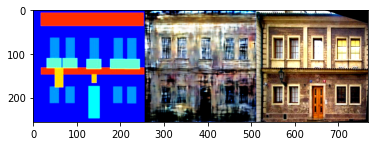

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


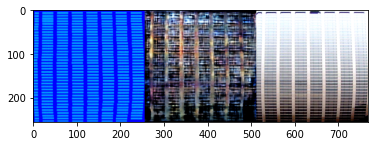

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


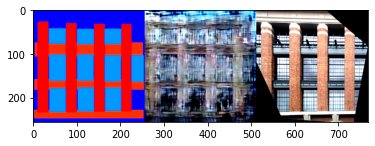

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


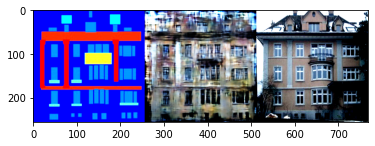


[221/500] - loss_d: 0.041, loss_g: 40.492



[222/500] - loss_d: 0.001, loss_g: 40.221



[223/500] - loss_d: 0.001, loss_g: 40.753



[224/500] - loss_d: 0.001, loss_g: 40.925



[225/500] - loss_d: 0.001, loss_g: 40.491



[226/500] - loss_d: 0.000, loss_g: 40.853



[227/500] - loss_d: 0.000, loss_g: 40.755



[228/500] - loss_d: 0.000, loss_g: 41.052



[229/500] - loss_d: 0.000, loss_g: 41.185



[230/500] - loss_d: 0.000, loss_g: 41.216


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


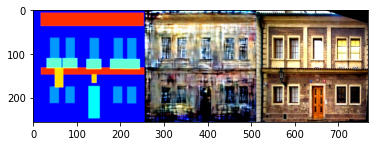

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


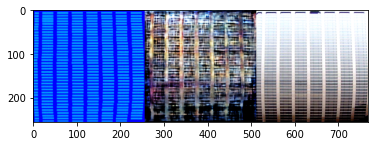

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


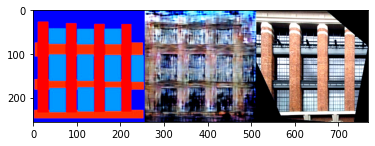

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


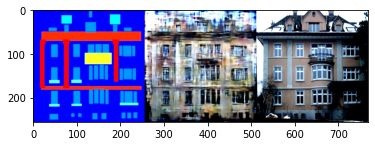


[231/500] - loss_d: 0.000, loss_g: 41.073



[232/500] - loss_d: 0.000, loss_g: 41.332



[233/500] - loss_d: 0.000, loss_g: 41.313



[234/500] - loss_d: 0.000, loss_g: 41.124



[235/500] - loss_d: 0.000, loss_g: 41.366



[236/500] - loss_d: 0.000, loss_g: 41.377



[237/500] - loss_d: 0.011, loss_g: 41.069



[238/500] - loss_d: 0.065, loss_g: 40.842



[239/500] - loss_d: 0.001, loss_g: 40.899



[240/500] - loss_d: 0.000, loss_g: 40.991


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


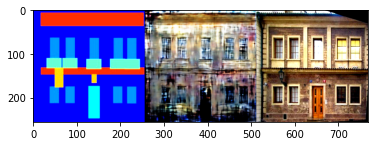

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


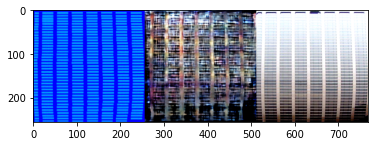

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


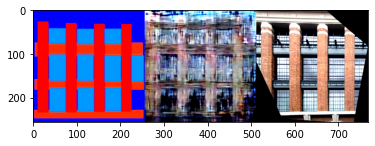

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


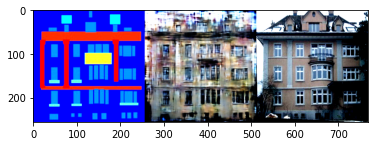


[241/500] - loss_d: 0.000, loss_g: 41.340



[242/500] - loss_d: 0.000, loss_g: 41.448



[243/500] - loss_d: 0.000, loss_g: 41.564



[244/500] - loss_d: 0.000, loss_g: 41.332



[245/500] - loss_d: 0.000, loss_g: 41.358



[246/500] - loss_d: 0.000, loss_g: 41.415



[247/500] - loss_d: 0.000, loss_g: 41.575



[248/500] - loss_d: 0.000, loss_g: 41.734



[249/500] - loss_d: 0.000, loss_g: 41.323



[250/500] - loss_d: 0.000, loss_g: 41.318


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


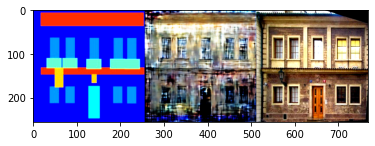

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


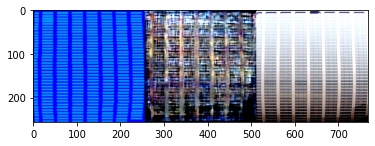

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


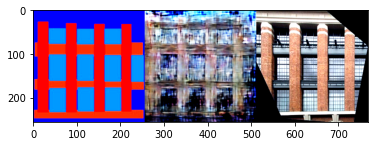

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


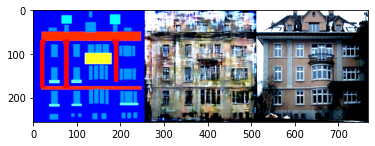


[251/500] - loss_d: 0.000, loss_g: 41.639



[252/500] - loss_d: 0.000, loss_g: 41.690



[253/500] - loss_d: 0.000, loss_g: 41.847



[254/500] - loss_d: 0.000, loss_g: 41.919



[255/500] - loss_d: 0.000, loss_g: 41.997



[256/500] - loss_d: 0.000, loss_g: 41.975



[257/500] - loss_d: 0.000, loss_g: 42.088



[258/500] - loss_d: 0.000, loss_g: 42.063



[259/500] - loss_d: 0.000, loss_g: 42.101



[260/500] - loss_d: 0.000, loss_g: 41.981


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


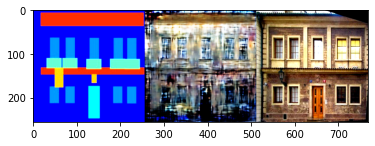

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


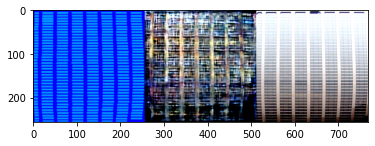

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


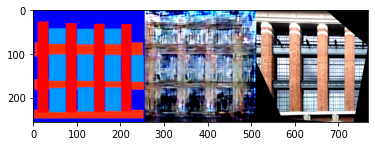

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


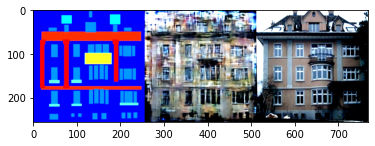


[261/500] - loss_d: 0.000, loss_g: 42.001



[262/500] - loss_d: 0.000, loss_g: 42.024



[263/500] - loss_d: 0.000, loss_g: 41.630



[264/500] - loss_d: 0.000, loss_g: 41.748



[265/500] - loss_d: 0.000, loss_g: 41.781



[266/500] - loss_d: 0.000, loss_g: 41.870



[267/500] - loss_d: 0.000, loss_g: 41.893



[268/500] - loss_d: 0.000, loss_g: 41.911



[269/500] - loss_d: 0.000, loss_g: 42.083



[270/500] - loss_d: 0.000, loss_g: 42.234


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


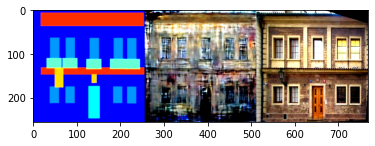

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


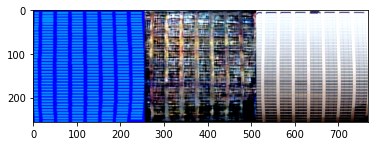

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


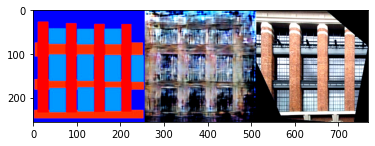

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


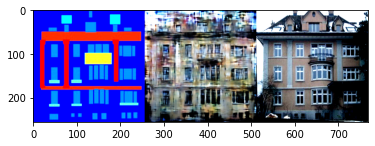


[271/500] - loss_d: 0.000, loss_g: 42.186



[272/500] - loss_d: 0.000, loss_g: 42.221



[273/500] - loss_d: 0.000, loss_g: 42.175



[274/500] - loss_d: 0.000, loss_g: 42.175



[275/500] - loss_d: 0.000, loss_g: 42.154



[276/500] - loss_d: 0.000, loss_g: 42.176



[277/500] - loss_d: 0.000, loss_g: 42.103



[278/500] - loss_d: 0.000, loss_g: 41.904



[279/500] - loss_d: 0.000, loss_g: 42.067



[280/500] - loss_d: 0.000, loss_g: 42.188


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


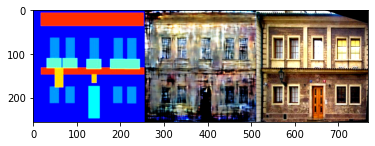

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


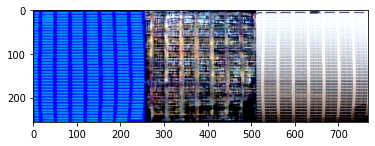

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


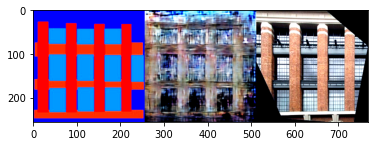

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


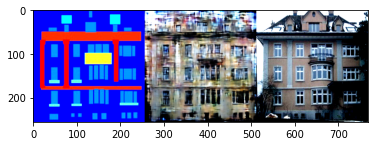


[281/500] - loss_d: 0.000, loss_g: 42.214



[282/500] - loss_d: 0.000, loss_g: 42.221



[283/500] - loss_d: 0.000, loss_g: 42.192



[284/500] - loss_d: 0.000, loss_g: 42.341



[285/500] - loss_d: 0.000, loss_g: 42.326



[286/500] - loss_d: 0.000, loss_g: 42.347



[287/500] - loss_d: 0.000, loss_g: 42.519



[288/500] - loss_d: 0.000, loss_g: 42.470



[289/500] - loss_d: 0.000, loss_g: 42.061



[290/500] - loss_d: 0.000, loss_g: 42.239


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


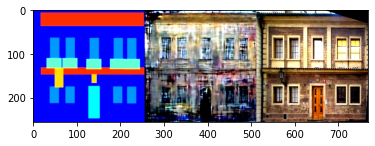

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


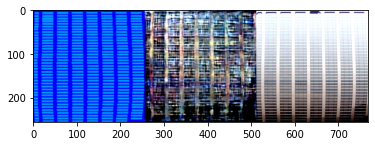

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


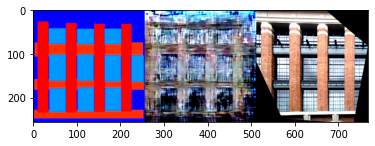

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


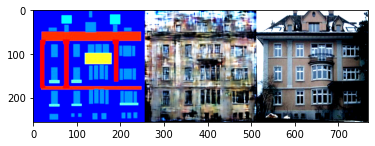


[291/500] - loss_d: 0.000, loss_g: 42.304



[292/500] - loss_d: 0.000, loss_g: 42.311



[293/500] - loss_d: 0.000, loss_g: 42.442



[294/500] - loss_d: 0.000, loss_g: 42.458



[295/500] - loss_d: 0.000, loss_g: 42.426



[296/500] - loss_d: 0.000, loss_g: 42.738



[297/500] - loss_d: 0.000, loss_g: 42.878



[298/500] - loss_d: 0.000, loss_g: 42.784



[299/500] - loss_d: 0.000, loss_g: 42.386



[300/500] - loss_d: 0.000, loss_g: 42.876


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


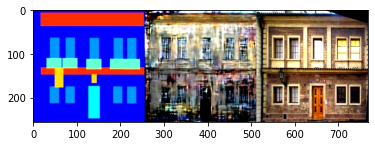

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


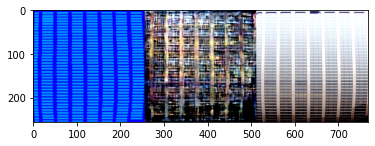

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


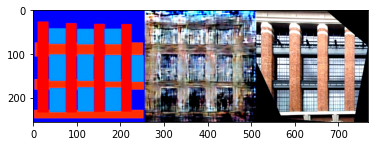

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


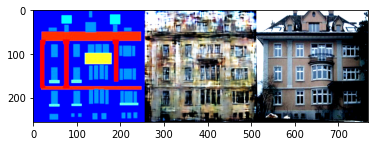


[301/500] - loss_d: 0.000, loss_g: 42.860



[302/500] - loss_d: 0.000, loss_g: 42.629



[303/500] - loss_d: 0.000, loss_g: 42.676



[304/500] - loss_d: 0.000, loss_g: 42.774



[305/500] - loss_d: 0.000, loss_g: 42.878



[306/500] - loss_d: 0.000, loss_g: 42.808



[307/500] - loss_d: 0.000, loss_g: 42.335



[308/500] - loss_d: 0.000, loss_g: 42.685



[309/500] - loss_d: 0.000, loss_g: 42.938



[310/500] - loss_d: 0.000, loss_g: 43.003


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


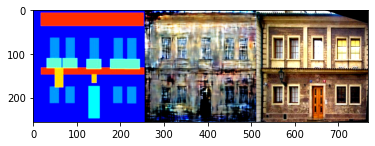

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


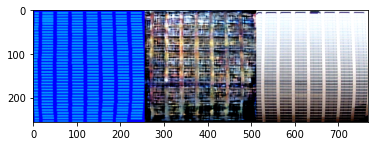

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


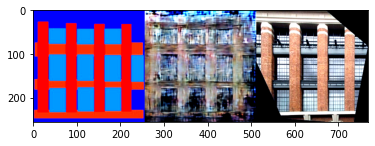

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


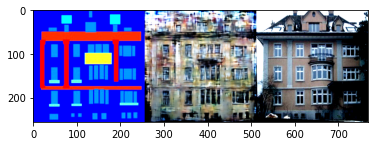


[311/500] - loss_d: 0.000, loss_g: 42.725



[312/500] - loss_d: 0.000, loss_g: 42.919



[313/500] - loss_d: 0.000, loss_g: 43.154



[314/500] - loss_d: 0.000, loss_g: 43.184



[315/500] - loss_d: 0.000, loss_g: 43.220



[316/500] - loss_d: 0.000, loss_g: 43.195



[317/500] - loss_d: 0.000, loss_g: 43.194



[318/500] - loss_d: 0.000, loss_g: 43.051



[319/500] - loss_d: 0.000, loss_g: 43.108



[320/500] - loss_d: 0.000, loss_g: 43.324


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


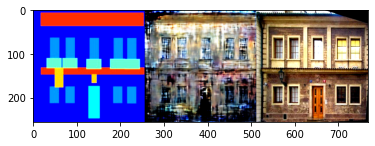

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


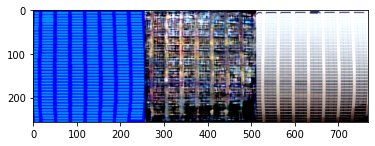

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


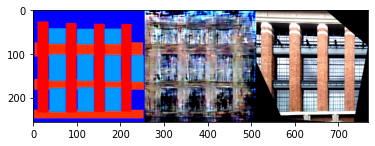

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


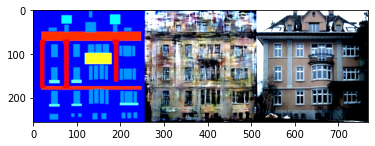


[321/500] - loss_d: 0.000, loss_g: 43.214



[322/500] - loss_d: 0.000, loss_g: 43.156



[323/500] - loss_d: 0.000, loss_g: 43.046



[324/500] - loss_d: 0.000, loss_g: 42.879



[325/500] - loss_d: 0.000, loss_g: 43.074



[326/500] - loss_d: 0.000, loss_g: 43.164



[327/500] - loss_d: 0.000, loss_g: 43.278



[328/500] - loss_d: 0.000, loss_g: 43.380



[329/500] - loss_d: 0.000, loss_g: 43.420



[330/500] - loss_d: 0.000, loss_g: 43.244


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


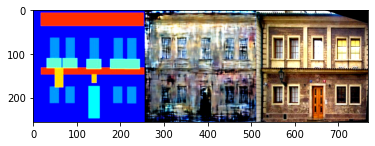

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


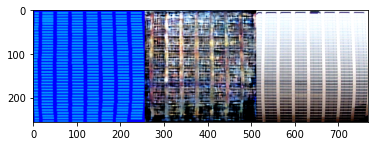

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


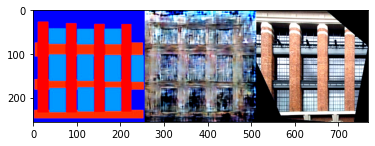

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


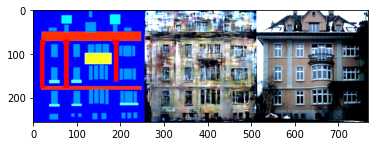


[331/500] - loss_d: 0.000, loss_g: 43.316



[332/500] - loss_d: 0.000, loss_g: 43.354



[333/500] - loss_d: 0.000, loss_g: 43.482



[334/500] - loss_d: 0.000, loss_g: 43.662



[335/500] - loss_d: 0.000, loss_g: 43.600



[336/500] - loss_d: 0.000, loss_g: 43.747



[337/500] - loss_d: 0.000, loss_g: 43.480



[338/500] - loss_d: 0.000, loss_g: 43.605



[339/500] - loss_d: 0.000, loss_g: 43.736



[340/500] - loss_d: 0.000, loss_g: 43.735


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


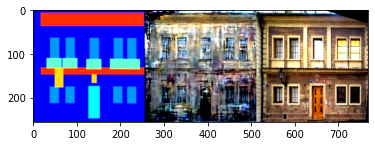

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


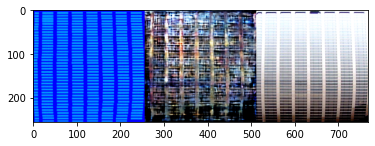

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


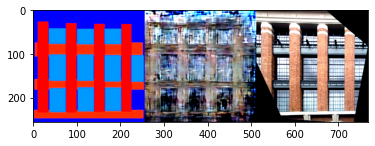

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


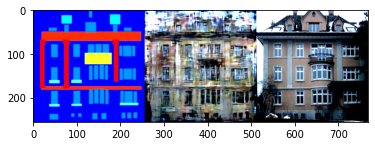


[341/500] - loss_d: 0.000, loss_g: 43.505



[342/500] - loss_d: 0.000, loss_g: 43.756



[343/500] - loss_d: 0.000, loss_g: 43.817



[344/500] - loss_d: 0.053, loss_g: 41.828



[345/500] - loss_d: 0.001, loss_g: 40.592



[346/500] - loss_d: 0.016, loss_g: 40.704



[347/500] - loss_d: 0.019, loss_g: 39.508



[348/500] - loss_d: 0.004, loss_g: 39.346



[349/500] - loss_d: 0.000, loss_g: 40.036



[350/500] - loss_d: 0.001, loss_g: 40.091


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


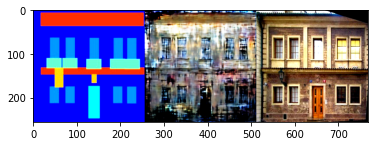

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


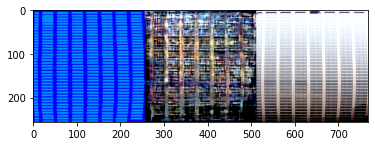

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


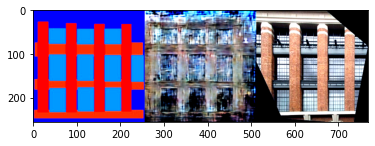

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


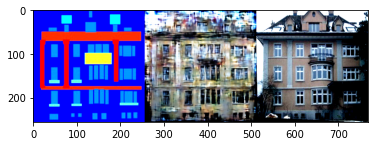


[351/500] - loss_d: 0.004, loss_g: 39.932



[352/500] - loss_d: 0.002, loss_g: 39.723



[353/500] - loss_d: 0.000, loss_g: 40.067



[354/500] - loss_d: 0.000, loss_g: 40.258



[355/500] - loss_d: 0.000, loss_g: 39.774



[356/500] - loss_d: 0.000, loss_g: 40.008



[357/500] - loss_d: 0.000, loss_g: 39.711



[358/500] - loss_d: 0.000, loss_g: 40.424



[359/500] - loss_d: 0.128, loss_g: 39.362



[360/500] - loss_d: 0.002, loss_g: 39.619


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


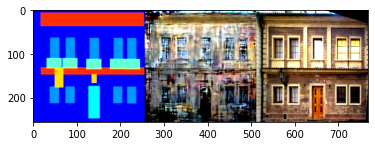

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


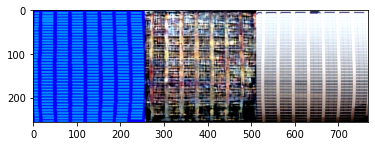

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


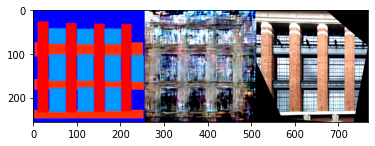

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


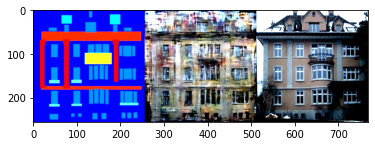


[361/500] - loss_d: 0.001, loss_g: 39.903



[362/500] - loss_d: 0.001, loss_g: 40.197



[363/500] - loss_d: 0.000, loss_g: 40.987



[364/500] - loss_d: 0.000, loss_g: 41.101



[365/500] - loss_d: 0.000, loss_g: 40.931



[366/500] - loss_d: 0.000, loss_g: 41.080



[367/500] - loss_d: 0.000, loss_g: 40.340



[368/500] - loss_d: 0.000, loss_g: 40.538



[369/500] - loss_d: 0.000, loss_g: 40.820



[370/500] - loss_d: 0.000, loss_g: 40.585


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


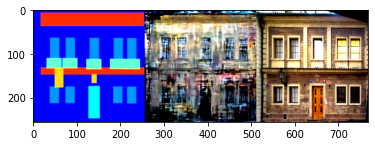

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


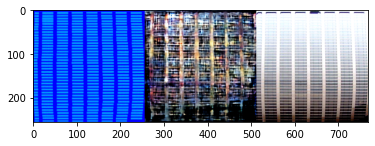

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


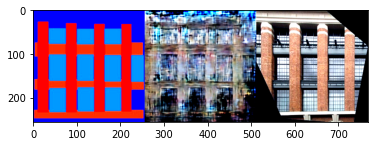

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


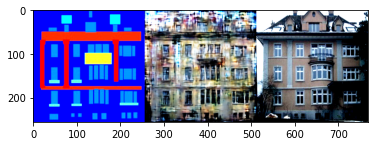


[371/500] - loss_d: 0.001, loss_g: 40.192



[372/500] - loss_d: 0.000, loss_g: 40.725



[373/500] - loss_d: 0.000, loss_g: 40.823



[374/500] - loss_d: 0.000, loss_g: 40.670



[375/500] - loss_d: 0.000, loss_g: 40.419



[376/500] - loss_d: 0.000, loss_g: 40.630



[377/500] - loss_d: 0.000, loss_g: 40.967



[378/500] - loss_d: 0.000, loss_g: 41.035



[379/500] - loss_d: 0.000, loss_g: 41.018



[380/500] - loss_d: 0.000, loss_g: 40.820


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


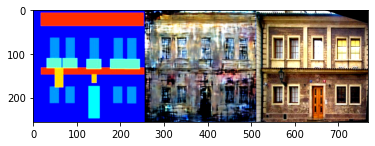

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


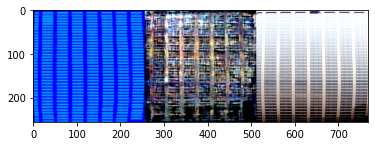

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


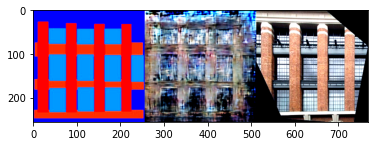

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


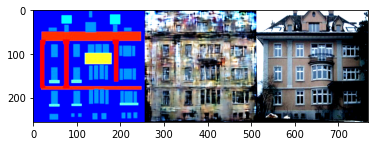


[381/500] - loss_d: 0.000, loss_g: 40.858



[382/500] - loss_d: 0.000, loss_g: 40.867



[383/500] - loss_d: 0.000, loss_g: 40.996



[384/500] - loss_d: 0.000, loss_g: 41.175



[385/500] - loss_d: 0.000, loss_g: 41.276



[386/500] - loss_d: 0.011, loss_g: 40.483



[387/500] - loss_d: 0.000, loss_g: 39.683



[388/500] - loss_d: 0.000, loss_g: 40.182



[389/500] - loss_d: 0.000, loss_g: 40.407



[390/500] - loss_d: 0.000, loss_g: 40.529


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


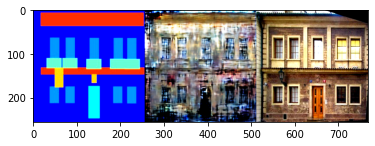

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


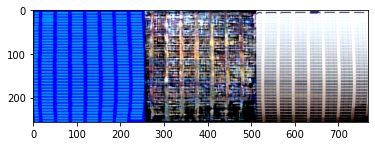

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


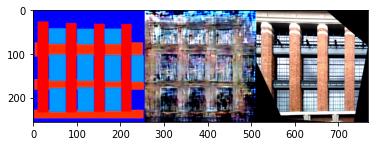

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


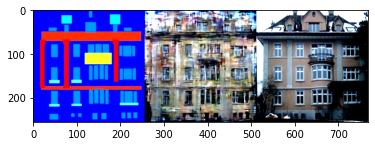


[391/500] - loss_d: 0.001, loss_g: 40.620



[392/500] - loss_d: 0.000, loss_g: 40.920



[393/500] - loss_d: 0.000, loss_g: 40.910



[394/500] - loss_d: 0.000, loss_g: 40.896



[395/500] - loss_d: 0.000, loss_g: 40.989



[396/500] - loss_d: 0.000, loss_g: 40.977



[397/500] - loss_d: 0.001, loss_g: 41.017



[398/500] - loss_d: 0.000, loss_g: 41.443



[399/500] - loss_d: 0.000, loss_g: 41.196



[400/500] - loss_d: 0.041, loss_g: 39.769


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


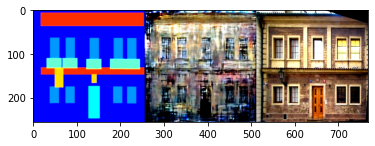

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


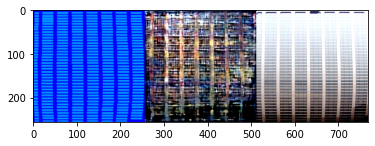

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


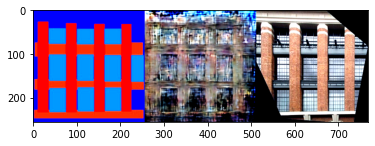

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


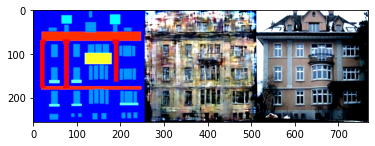


[401/500] - loss_d: 0.005, loss_g: 39.265



[402/500] - loss_d: 0.001, loss_g: 40.731



[403/500] - loss_d: 0.000, loss_g: 40.884



[404/500] - loss_d: 0.000, loss_g: 41.000



[405/500] - loss_d: 0.000, loss_g: 40.915



[406/500] - loss_d: 0.000, loss_g: 40.868



[407/500] - loss_d: 0.000, loss_g: 40.852



[408/500] - loss_d: 0.000, loss_g: 41.183



[409/500] - loss_d: 0.000, loss_g: 41.294



[410/500] - loss_d: 0.010, loss_g: 40.849


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


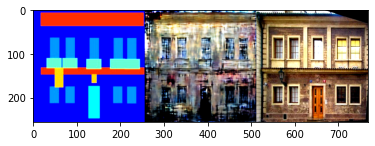

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


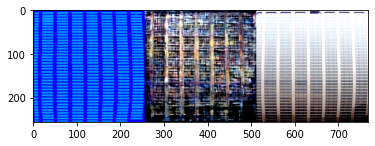

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


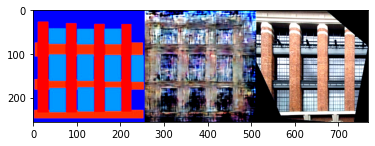

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


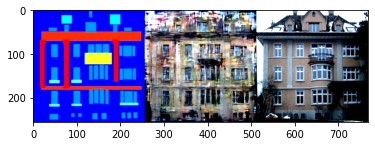


[411/500] - loss_d: 0.001, loss_g: 40.829



[412/500] - loss_d: 0.000, loss_g: 40.914



[413/500] - loss_d: 0.000, loss_g: 40.580



[414/500] - loss_d: 0.000, loss_g: 40.501



[415/500] - loss_d: 0.001, loss_g: 39.245



[416/500] - loss_d: 0.000, loss_g: 40.586



[417/500] - loss_d: 0.000, loss_g: 41.133



[418/500] - loss_d: 0.000, loss_g: 40.853



[419/500] - loss_d: 0.000, loss_g: 40.817



[420/500] - loss_d: 0.000, loss_g: 40.877


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


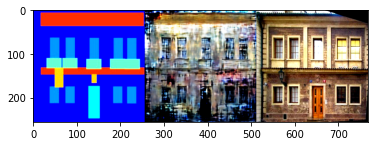

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


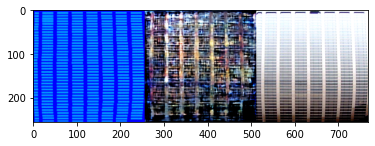

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


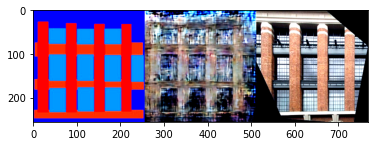

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


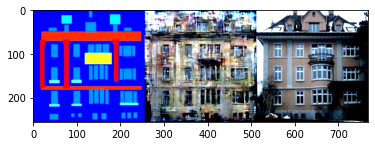


[421/500] - loss_d: 0.000, loss_g: 40.915



[422/500] - loss_d: 0.000, loss_g: 40.818



[423/500] - loss_d: 0.000, loss_g: 40.953



[424/500] - loss_d: 0.000, loss_g: 41.056



[425/500] - loss_d: 0.000, loss_g: 41.034



[426/500] - loss_d: 0.000, loss_g: 40.798



[427/500] - loss_d: 0.000, loss_g: 40.978



[428/500] - loss_d: 0.077, loss_g: 39.618



[429/500] - loss_d: 0.001, loss_g: 39.252



[430/500] - loss_d: 0.000, loss_g: 39.698


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


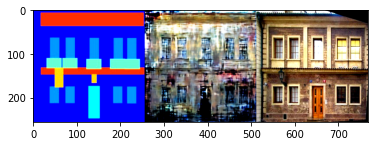

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


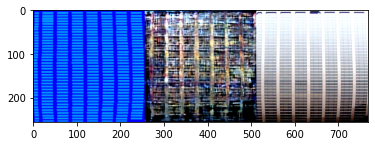

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


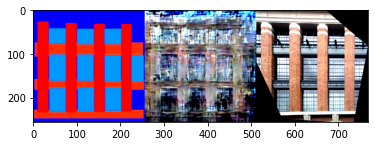

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


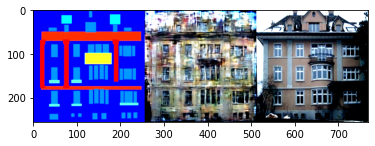


[431/500] - loss_d: 0.000, loss_g: 39.894



[432/500] - loss_d: 0.000, loss_g: 40.064



[433/500] - loss_d: 0.000, loss_g: 40.326



[434/500] - loss_d: 0.000, loss_g: 40.287



[435/500] - loss_d: 0.000, loss_g: 40.155



[436/500] - loss_d: 0.000, loss_g: 40.447



[437/500] - loss_d: 0.000, loss_g: 40.389



[438/500] - loss_d: 0.000, loss_g: 39.735



[439/500] - loss_d: 0.000, loss_g: 39.827



[440/500] - loss_d: 0.000, loss_g: 40.197


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


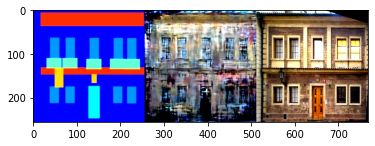

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


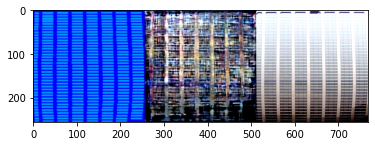

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


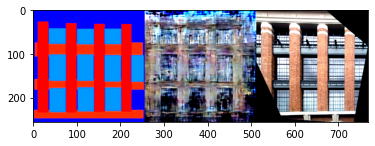

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


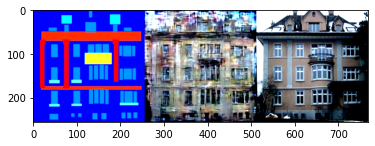


[441/500] - loss_d: 0.000, loss_g: 40.356



[442/500] - loss_d: 0.000, loss_g: 40.464



[443/500] - loss_d: 0.000, loss_g: 40.480



[444/500] - loss_d: 0.000, loss_g: 40.098



[445/500] - loss_d: 0.000, loss_g: 40.406



[446/500] - loss_d: 0.000, loss_g: 40.620



[447/500] - loss_d: 0.000, loss_g: 40.689



[448/500] - loss_d: 0.000, loss_g: 40.856



[449/500] - loss_d: 0.000, loss_g: 40.930



[450/500] - loss_d: 0.076, loss_g: 39.372


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


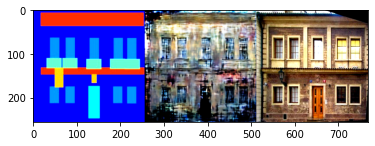

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


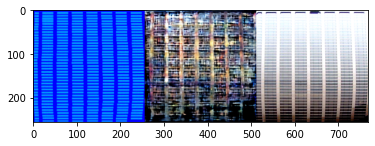

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


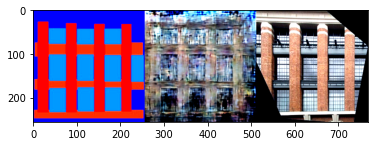

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


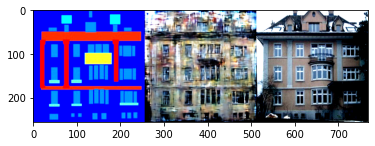


[451/500] - loss_d: 0.001, loss_g: 38.255



[452/500] - loss_d: 0.001, loss_g: 40.593



[453/500] - loss_d: 0.001, loss_g: 39.254



[454/500] - loss_d: 0.000, loss_g: 39.140



[455/500] - loss_d: 0.000, loss_g: 39.527



[456/500] - loss_d: 0.000, loss_g: 39.417



[457/500] - loss_d: 0.000, loss_g: 39.741



[458/500] - loss_d: 0.000, loss_g: 40.429



[459/500] - loss_d: 0.000, loss_g: 40.374



[460/500] - loss_d: 0.000, loss_g: 40.448


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


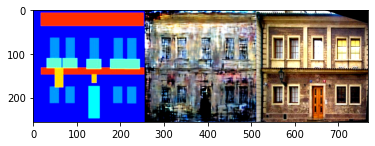

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


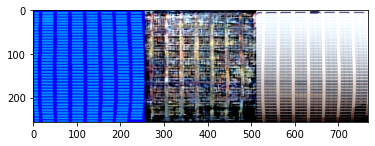

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


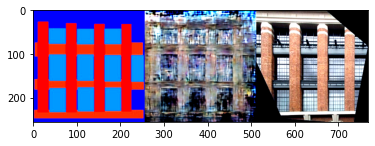

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


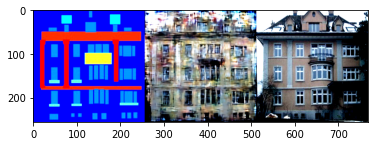


[461/500] - loss_d: 0.000, loss_g: 40.504



[462/500] - loss_d: 0.000, loss_g: 40.088



[463/500] - loss_d: 0.000, loss_g: 39.884



[464/500] - loss_d: 0.000, loss_g: 40.565



[465/500] - loss_d: 0.000, loss_g: 40.686



[466/500] - loss_d: 0.000, loss_g: 40.655



[467/500] - loss_d: 0.000, loss_g: 40.723



[468/500] - loss_d: 0.000, loss_g: 40.554



[469/500] - loss_d: 0.000, loss_g: 40.525



[470/500] - loss_d: 0.000, loss_g: 40.705


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


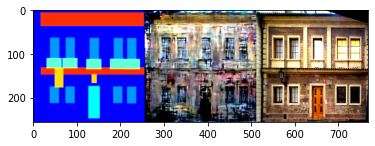

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


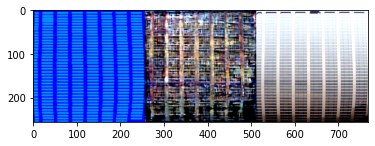

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


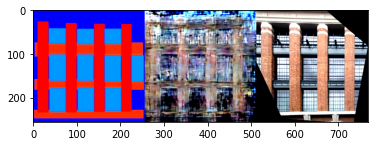

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


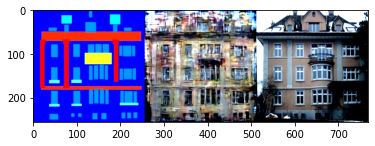


[471/500] - loss_d: 0.000, loss_g: 40.810



[472/500] - loss_d: 0.006, loss_g: 40.597



[473/500] - loss_d: 0.027, loss_g: 40.323



[474/500] - loss_d: 0.001, loss_g: 39.650



[475/500] - loss_d: 0.000, loss_g: 40.024



[476/500] - loss_d: 0.000, loss_g: 40.164



[477/500] - loss_d: 0.000, loss_g: 40.161



[478/500] - loss_d: 0.000, loss_g: 40.339



[479/500] - loss_d: 0.000, loss_g: 40.507



[480/500] - loss_d: 0.000, loss_g: 40.735


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


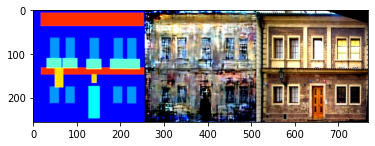

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


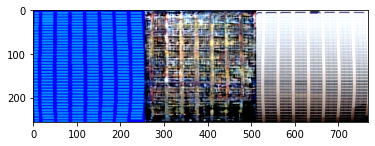

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


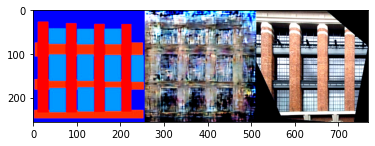

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


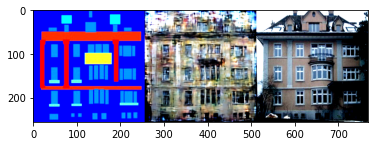


[481/500] - loss_d: 0.000, loss_g: 40.684



[482/500] - loss_d: 0.054, loss_g: 40.077



[483/500] - loss_d: 0.020, loss_g: 41.214



[484/500] - loss_d: 0.004, loss_g: 39.649



[485/500] - loss_d: 0.000, loss_g: 40.365



[486/500] - loss_d: 0.000, loss_g: 39.748



[487/500] - loss_d: 0.001, loss_g: 39.259



[488/500] - loss_d: 0.000, loss_g: 39.642



[489/500] - loss_d: 0.001, loss_g: 39.358



[490/500] - loss_d: 0.000, loss_g: 40.323


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


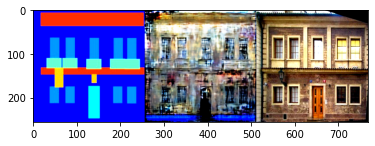

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


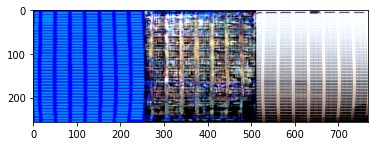

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


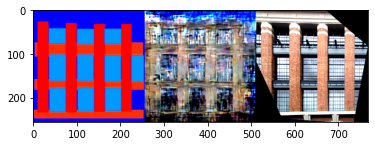

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


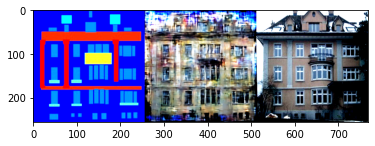


[491/500] - loss_d: 0.000, loss_g: 40.622



[492/500] - loss_d: 0.000, loss_g: 40.889



[493/500] - loss_d: 0.000, loss_g: 40.814



[494/500] - loss_d: 0.000, loss_g: 40.868



[495/500] - loss_d: 0.000, loss_g: 41.144



[496/500] - loss_d: 0.000, loss_g: 40.955



[497/500] - loss_d: 0.001, loss_g: 39.680



[498/500] - loss_d: 0.000, loss_g: 39.379



[499/500] - loss_d: 0.000, loss_g: 40.331


In [ ]:
start_epoch = 0
end_epoch = 500
L1_lambda = 100

for epoch in range(start_epoch, end_epoch):
    D_loss = []
    D_l_fake = []
    D_l_real = []

    G_loss = []
    G_l_l1 = []

    for batch_1, batch_2 in tqdm(loader_train):
        D.train()
        G.train()

        # train discriminator D
        D.zero_grad()
        for params in G.parameters(): params.requires_grad = False
        for params in D.parameters(): params.requires_grad = True

        x_, y_ = batch_1.cuda(), batch_2.cuda()

        D_result = D(x_, y_).squeeze()
        D_real_loss = BCE_loss(D_result, torch.ones(D_result.size()).cuda())

        G_result = G(x_)
        D_result = D(x_, G_result).squeeze()
        D_fake_loss = BCE_loss(D_result, torch.zeros(D_result.size()).cuda())

        D_l_fake.append(D_fake_loss.item())
        D_l_real.append(D_real_loss.item())

        D_train_loss = (D_real_loss + D_fake_loss) * 0.5
        D_train_loss.backward()
        D_optimizer.step()

        D_loss.append(D_train_loss.item())

        # train generator G
        G.zero_grad()
        for params in G.parameters(): params.requires_grad = True
        for params in D.parameters(): params.requires_grad = False

        G_result = G(x_)
        D_result = D(x_, G_result).squeeze()
        l1_loss = L1_loss(G_result, y_)
        G_l_l1.append(l1_loss.item())

        G_train_loss = BCE_loss(D_result, torch.ones(D_result.size()).cuda()) + L1_lambda * l1_loss
        G_train_loss.backward()
        G_optimizer.step()

        G_loss.append(G_train_loss.item())

    print('[%d/%d] - loss_d: %.3f, loss_g: %.3f' % (epoch, end_epoch, torch.mean(torch.FloatTensor(D_loss)),
                                                              torch.mean(torch.FloatTensor(G_loss))))
    train_hist['D_loss'].append(np.mean(D_loss))
    train_hist['D_l_fake'].append(np.mean(D_l_fake))
    train_hist['D_l_real'].append(np.mean(D_l_real))
    train_hist['G_l_l1'].append(np.mean(G_l_l1))
    train_hist['G_loss'].append(np.mean(G_loss))
    

    D_loss = []
    D_l_fake = []
    D_l_real = []

    G_loss = []
    G_l_l1 = []
    
    # valid block
    for batch_1, batch_2 in tqdm(loader_val):
        D.eval()
        G.eval()

        x_, y_ = batch_1.cuda(), batch_2.cuda()

        D_result = D(x_, y_).squeeze()
        D_real_loss = BCE_loss(D_result, torch.ones(D_result.size()).cuda())

        G_result = G(x_)
        D_result = D(x_, G_result).squeeze()
        D_fake_loss = BCE_loss(D_result, torch.zeros(D_result.size()).cuda())

        D_l_fake.append(D_fake_loss.item())
        D_l_real.append(D_real_loss.item())

        D_train_loss = (D_real_loss + D_fake_loss) * 0.5
        D_loss.append(D_train_loss.item())


        G_result = G(x_)
        D_result = D(x_, G_result).squeeze()
        l1_loss = L1_loss(G_result, y_)
        G_l_l1.append(l1_loss.item())

        G_train_loss = BCE_loss(D_result, torch.ones(D_result.size()).cuda()) + L1_lambda * l1_loss
        G_loss.append(G_train_loss.item())

    val_hist['D_loss'].append(np.mean(D_loss))
    val_hist['D_l_fake'].append(np.mean(D_l_fake))
    val_hist['D_l_real'].append(np.mean(D_l_real))
    val_hist['G_l_l1'].append(np.mean(G_l_l1))
    val_hist['G_loss'].append(np.mean(G_loss))

    # show result
    if epoch % 10 == 0:
      show_result(G, loader_val, epoch)
    # save_model
    if (epoch + 1) % 50 == 0:
        torch.save({
            'G': G.state_dict(),
            'D': D.state_dict(),
            'G_optim': G_optimizer.state_dict(),
            'D_optim' : D_optimizer.state_dict(),
            'epoch': epoch
        }, f"./drive/MyDrive/gan_l1/DL3model_{epoch}.pth")

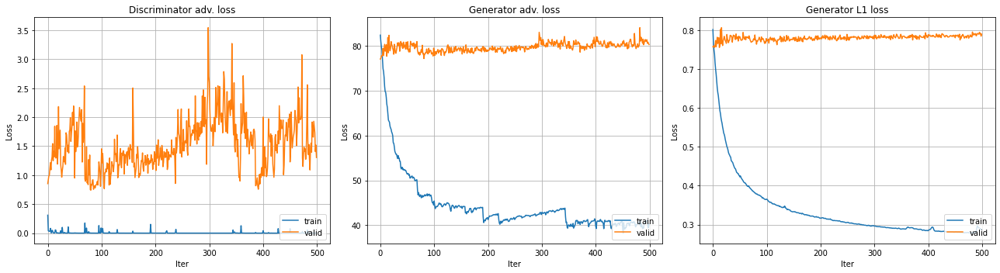

In [ ]:
plt.figure(figsize=(18, 5))

plt.subplot(1, 3, 1)

x = range(len(train_hist['D_loss']))

y1 = train_hist['D_loss']
y2 = val_hist['D_loss']

plt.plot(x, y1, label='train')
plt.plot(x, y2, label='valid')

plt.title('Discriminator adv. loss')
plt.xlabel('Iter')
plt.ylabel('Loss')

plt.legend(loc=4)
plt.grid(True)
plt.tight_layout()

plt.subplot(1, 3, 2)

x = range(len(train_hist['G_loss']))

y1 = train_hist['G_loss']
y2 = val_hist['G_loss']

plt.plot(x, y1, label='train')
plt.plot(x, y2, label='valid')

plt.title('Generator adv. loss')
plt.xlabel('Iter')
plt.ylabel('Loss')

plt.legend(loc=4)
plt.grid(True)
plt.tight_layout()

plt.subplot(1, 3, 3)
x = range(len(train_hist['G_l_l1']))

y1 = train_hist['G_l_l1']
y2 = val_hist['G_l_l1']

plt.plot(x, y1, label='train')
plt.plot(x, y2, label='valid')

plt.title('Generator L1 loss')
plt.xlabel('Iter')
plt.ylabel('Loss')
plt.legend(loc=4)
plt.grid(True)
plt.tight_layout()

plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


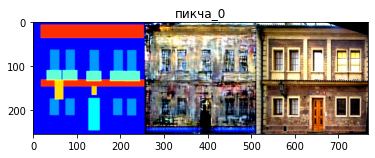

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


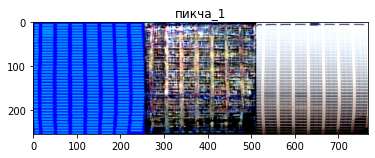

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


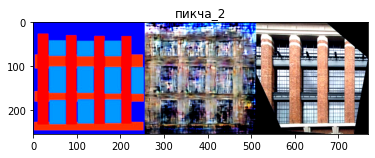

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


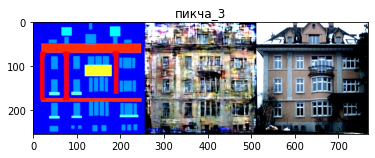

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


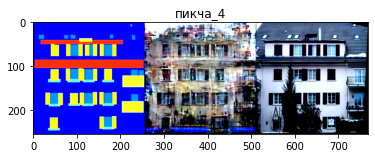

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


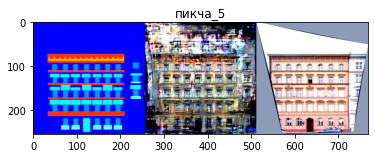

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


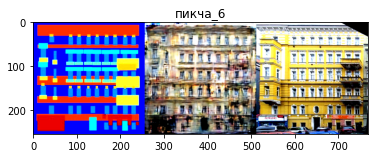

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


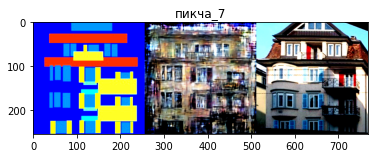

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


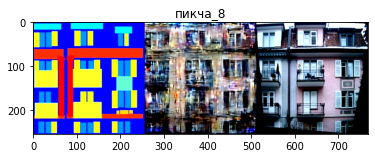

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


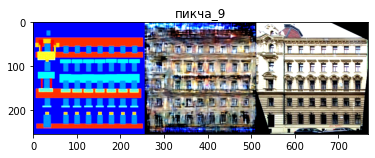

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


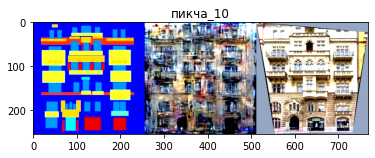

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


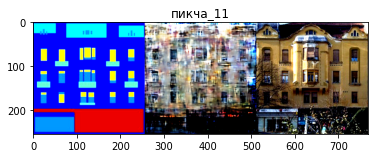

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


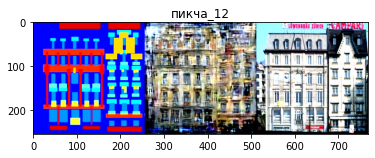

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


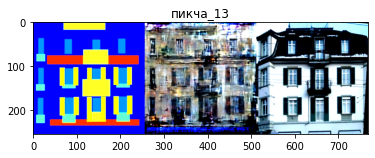

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


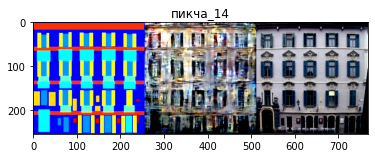

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


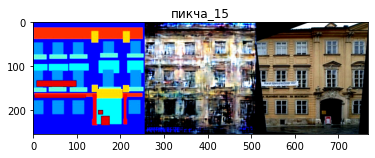

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


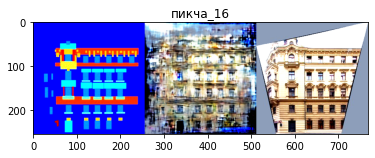

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


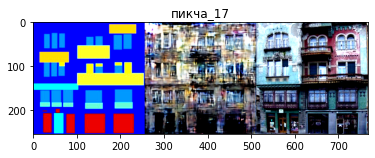

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


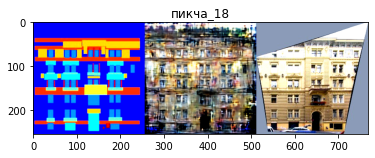

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


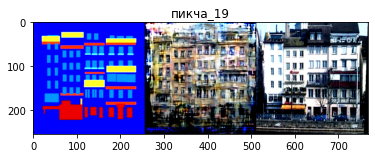

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


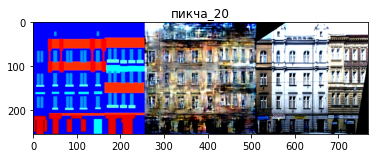

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


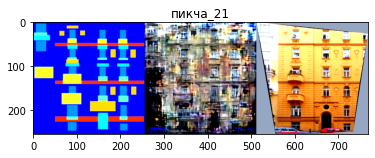

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


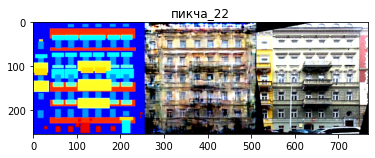

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


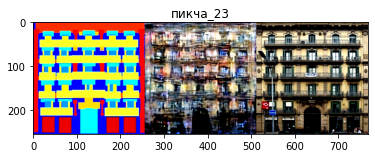

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


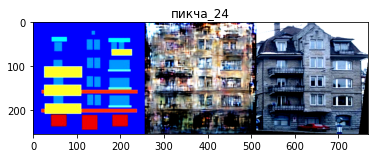

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


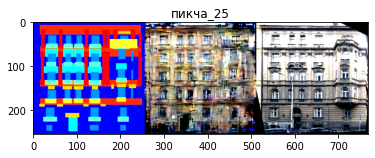

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


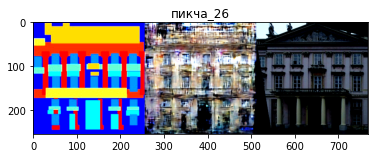

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


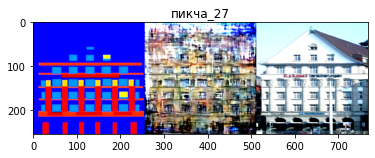

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


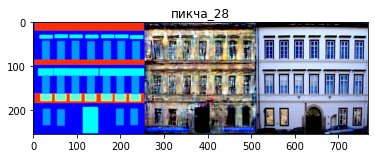

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


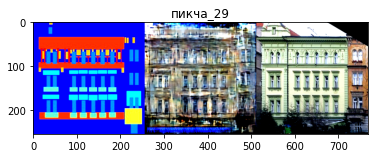

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


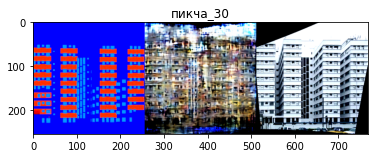

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


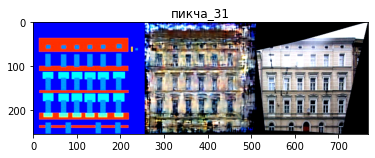

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


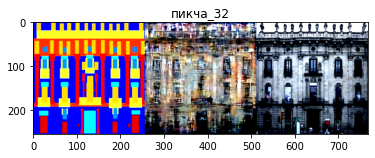

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


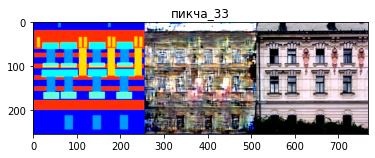

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


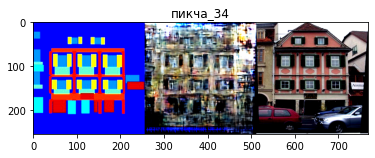

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


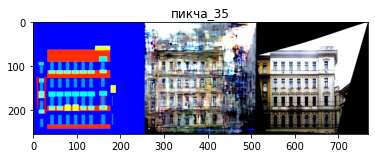

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


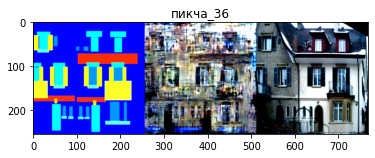

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


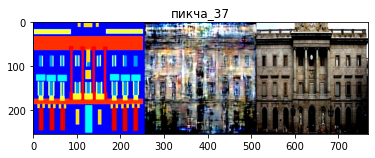

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


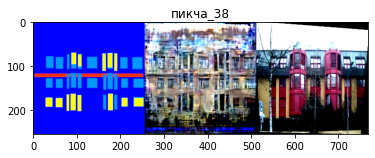

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


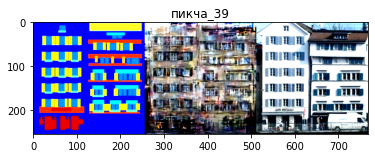

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


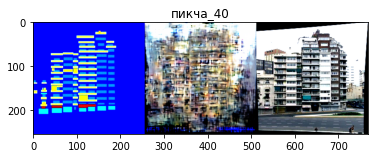

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


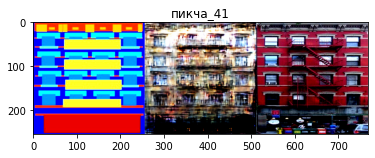

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


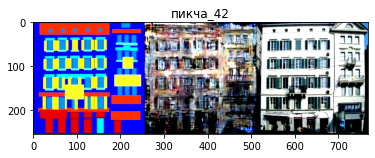

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


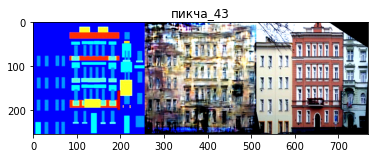

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


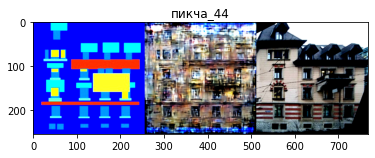

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


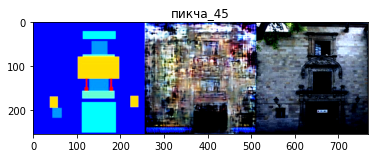

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


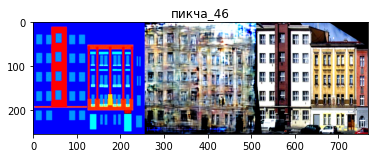

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


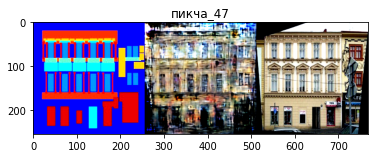

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


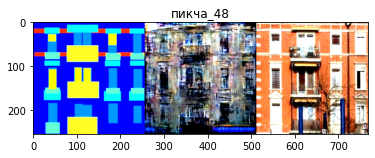

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


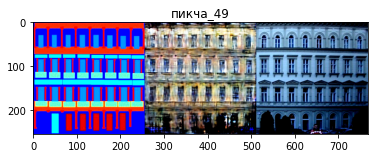

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


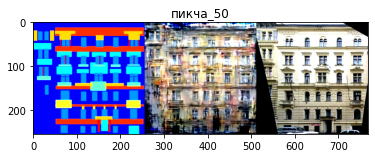

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


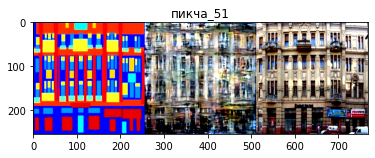

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


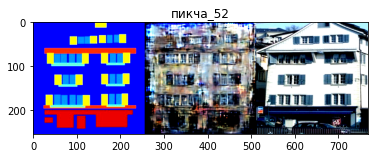

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


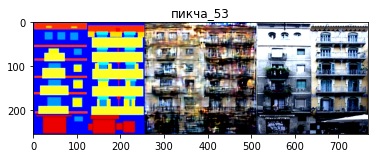

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


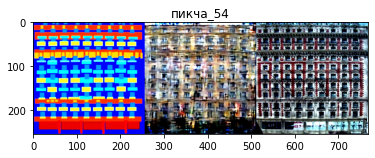

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


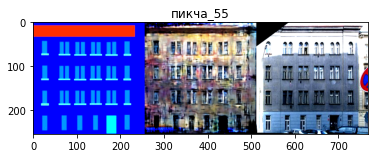

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


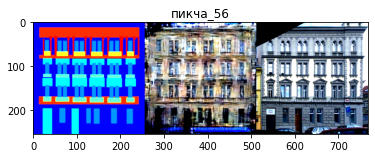

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


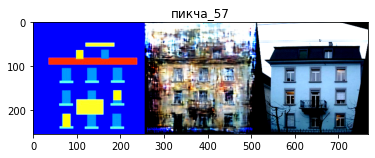

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


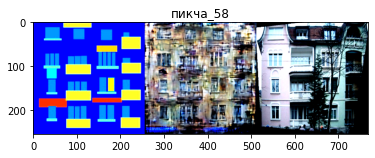

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


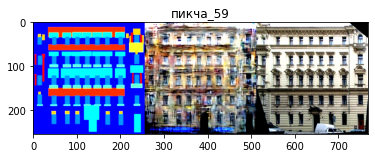

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


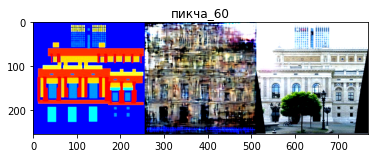

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


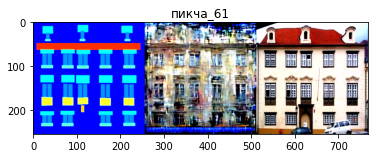

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


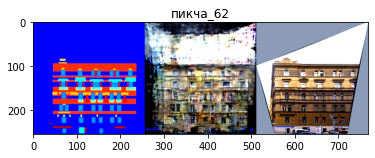

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


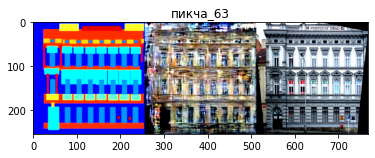

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


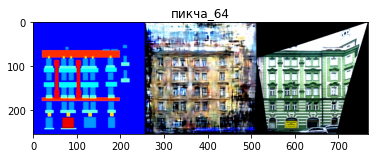

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


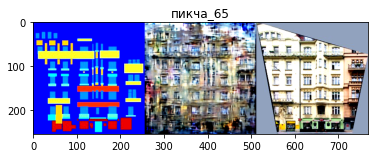

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


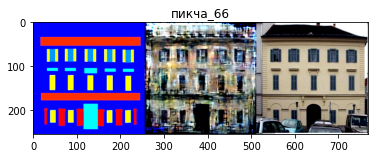

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


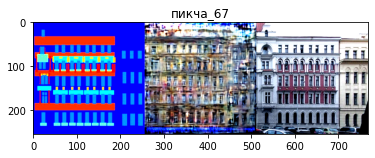

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


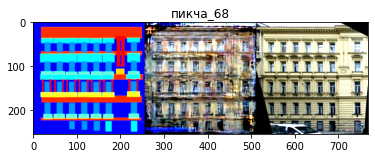

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


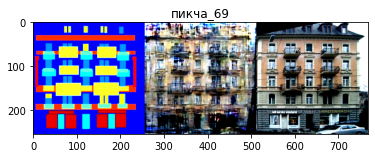

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


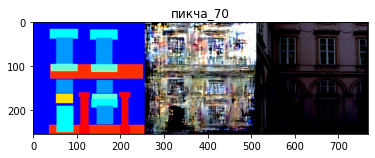

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


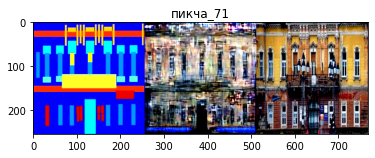

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


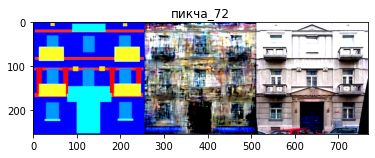

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


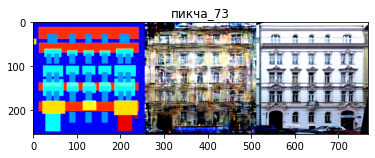

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


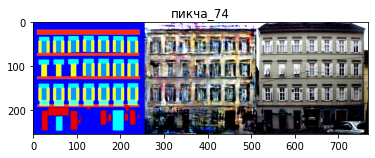

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


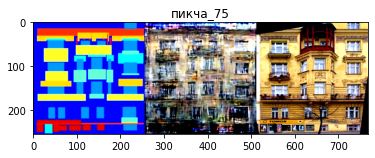

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


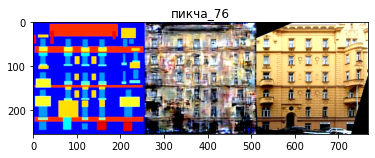

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


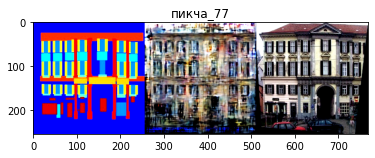

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


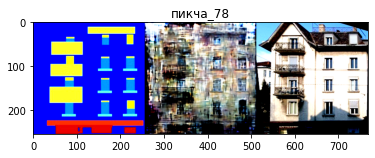

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


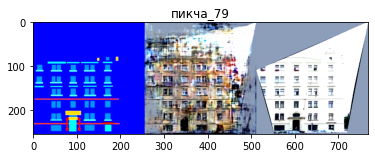

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


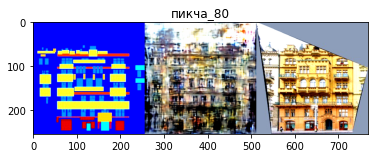

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


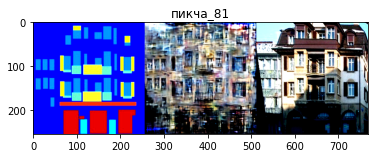

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


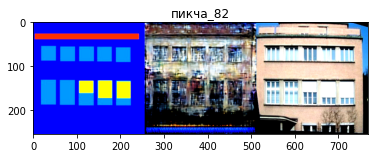

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


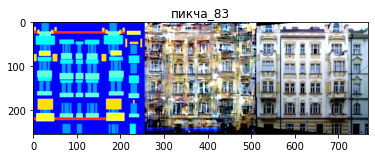

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


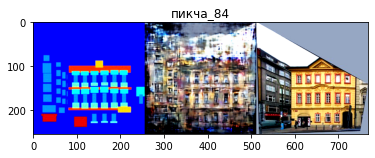

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


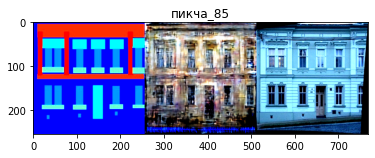

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


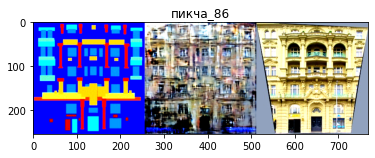

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


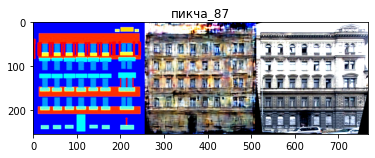

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


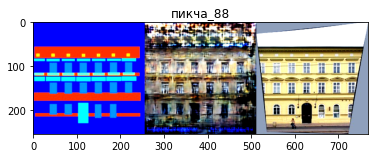

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


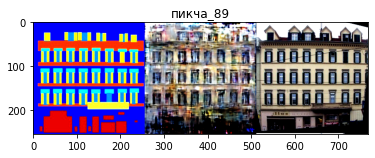

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


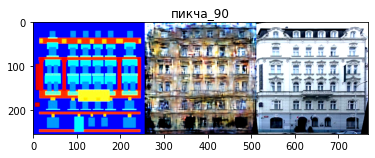

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


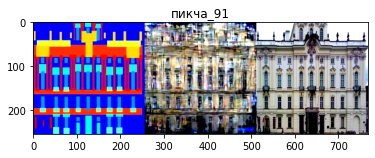

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


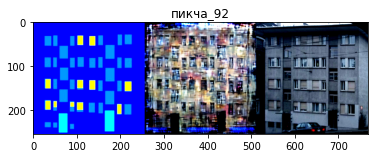

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


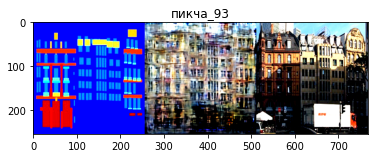

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


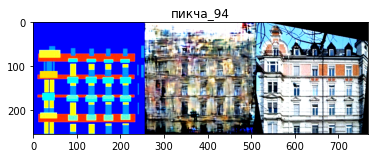

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


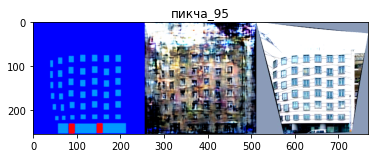

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


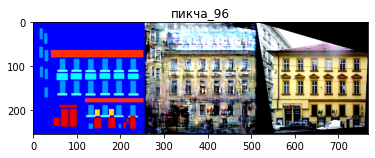

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


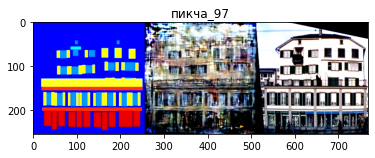

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


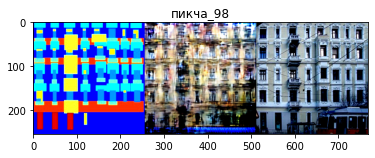

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


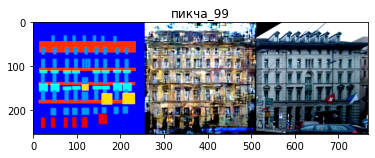

In [ ]:
import matplotlib.pyplot as plt
import numpy as np


G.eval()
cnt = 0

for batch_1, batch_2 in loader_val:
  outlines = []
  target = []
  predict = []
  fake_2 = G(batch_1.cuda())
  outlines = batch_1
  target = batch_2
  predict = fake_2.cpu()

  for i in range(predict.shape[0]):
      concat_image = (torch.cat([outlines[i], predict[i], target[i]], dim=-1) + 1.) / 2.
      plt.title("пикча_" + str(cnt))
      plt.imshow(np.transpose(concat_image.detach().numpy(), (1,2,0)))
      plt.savefig('./res_pic_500/' + str(cnt) + '.png')
      cnt += 1
      plt.show()

In [ ]:
PATH = './drive/MyDrive/gan_l1/DL3model_299.pth'

checkpoint = torch.load(PATH)
G.load_state_dict(checkpoint['G'])
G_optimizer.load_state_dict(checkpoint['G_optim'])

D.load_state_dict(checkpoint['D'])
D_optimizer.load_state_dict(checkpoint['D_optim'])
epoch_start = checkpoint['epoch']

In [ ]:
class UnNormalize(object):
    def __init__(self, mean, std):
        self.mean = mean
        self.std = std

    def __call__(self, tensor):
        """
        Args:
            tensor (Tensor): Tensor image of size (C, H, W) to be normalized.
        Returns:
            Tensor: Normalized image.
        """
        for t, m, s in zip(tensor, self.mean, self.std):
            t.mul_(s).add_(m)
            # The normalize code -> t.sub_(m).div_(s)
        return tensor

In [ ]:
unorm = UnNormalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


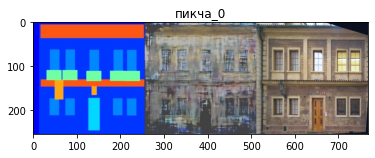

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


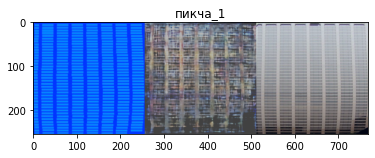

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


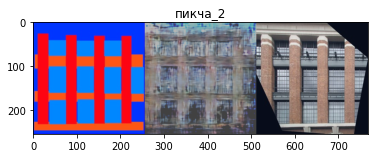

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


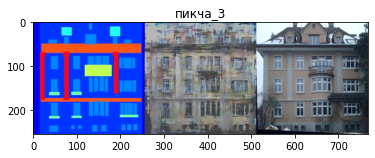

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


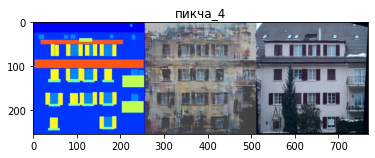

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


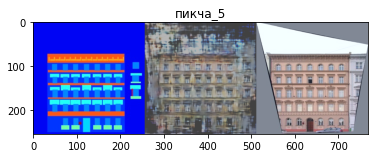

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


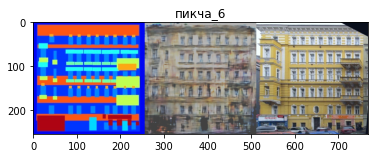

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


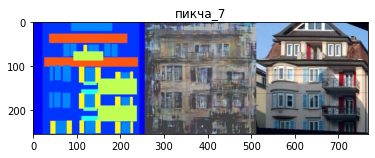

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


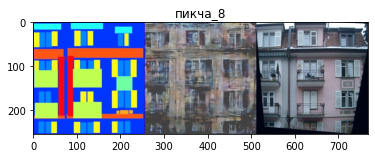

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


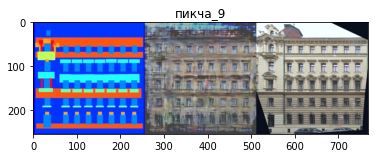

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


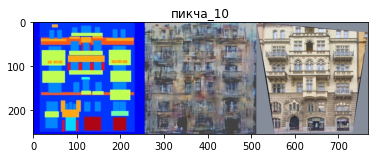

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


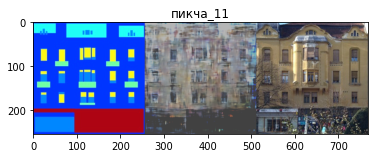

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


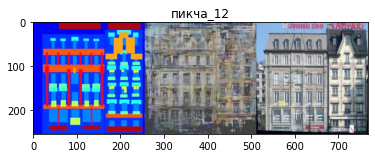

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


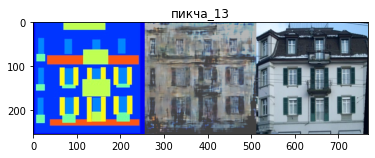

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


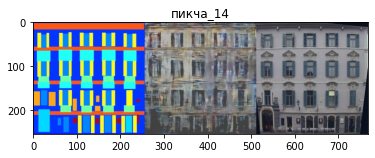

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


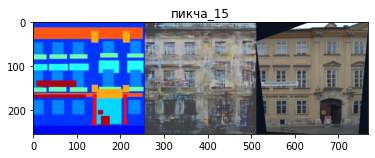

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


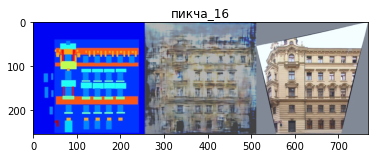

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


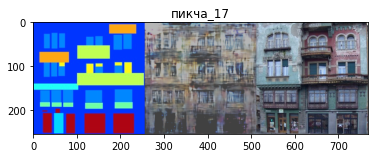

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


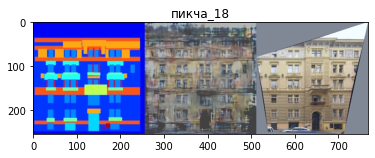

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


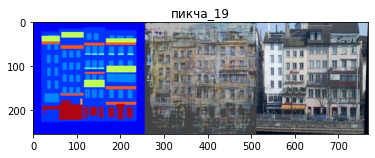

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


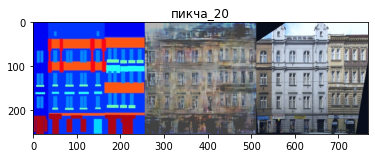

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


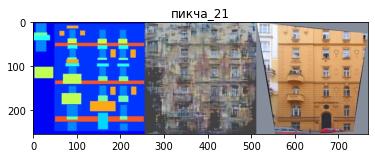

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


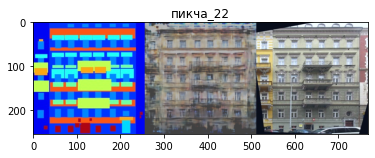

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


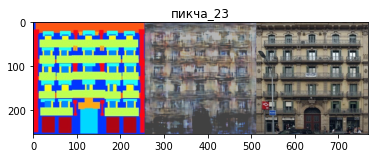

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


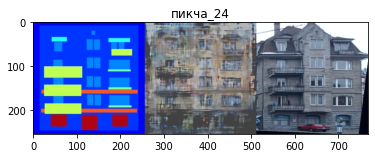

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


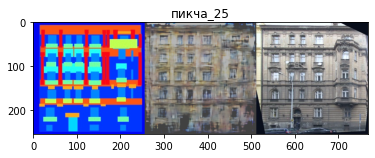

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


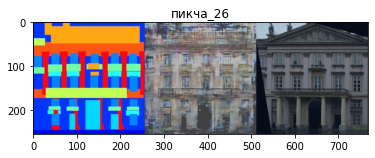

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


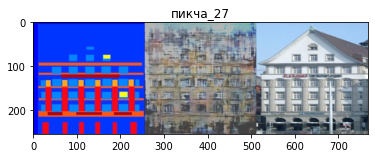

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


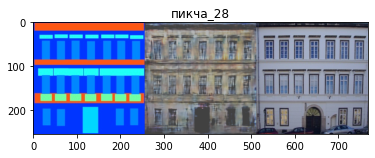

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


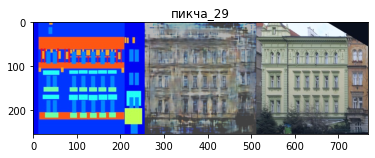

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


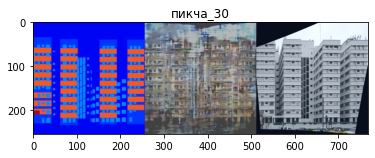

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


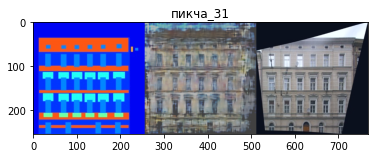

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


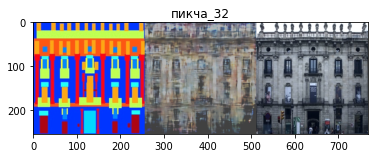

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


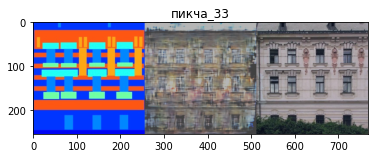

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


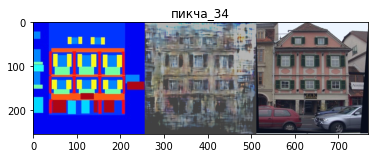

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


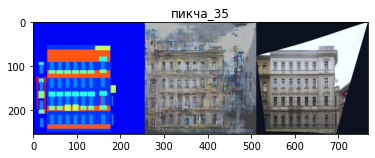

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


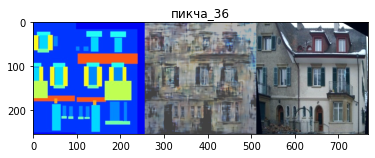

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


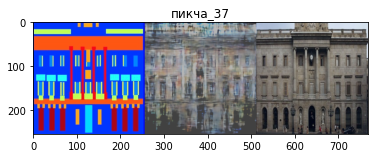

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


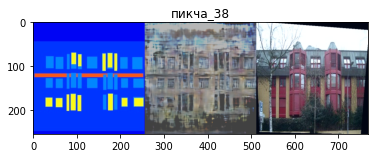

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


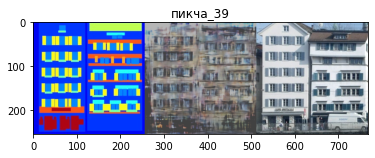

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


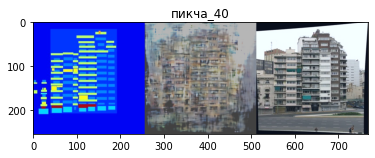

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


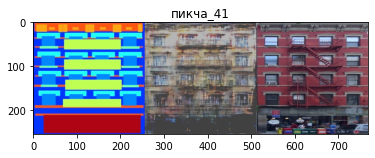

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


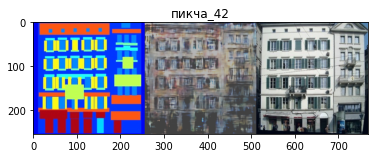

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


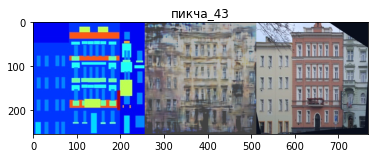

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


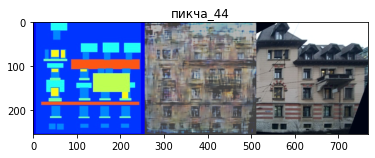

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


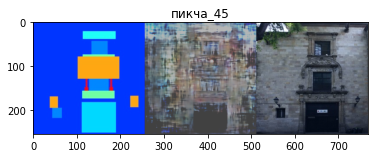

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


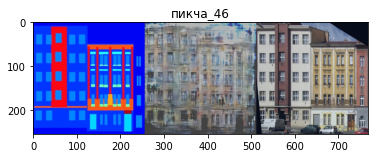

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


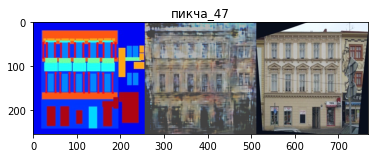

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


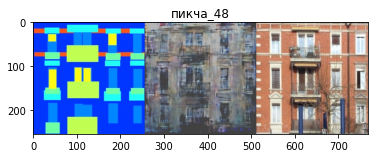

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


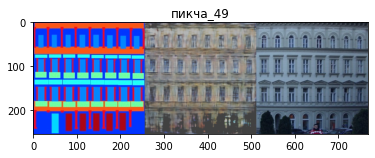

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


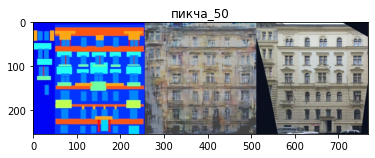

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


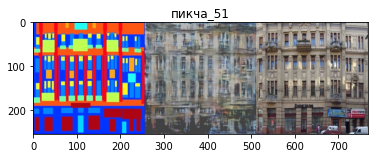

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


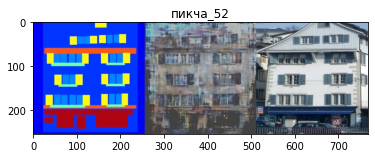

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


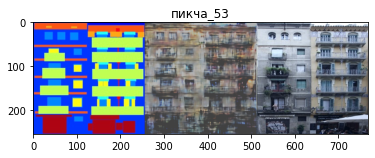

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


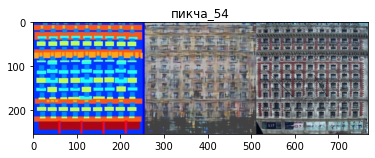

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


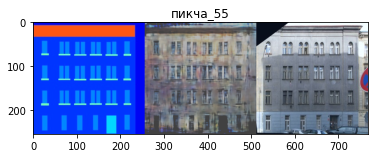

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


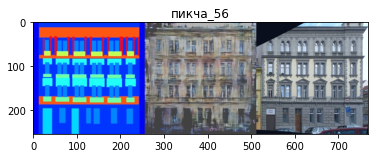

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


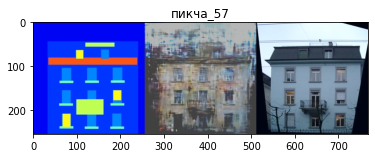

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


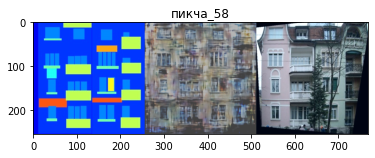

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


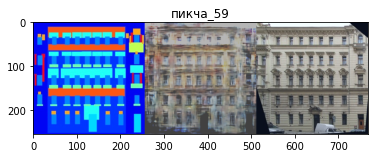

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


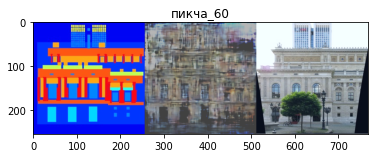

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


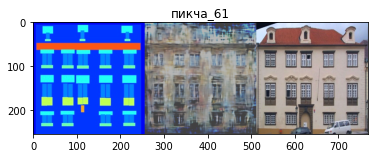

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


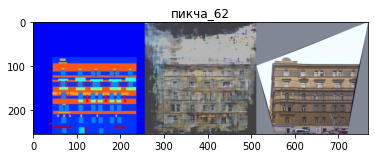

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


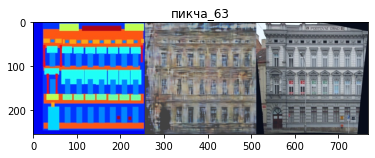

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


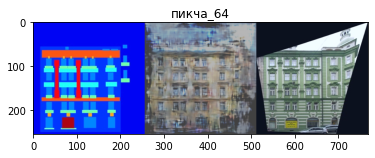

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


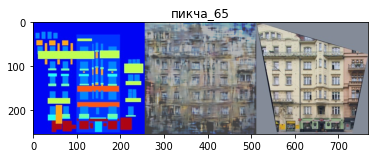

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


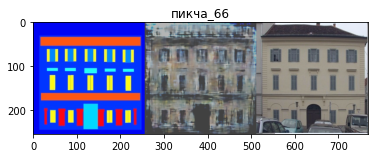

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


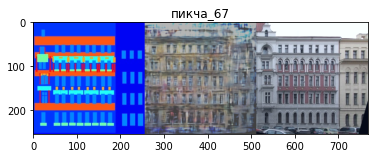

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


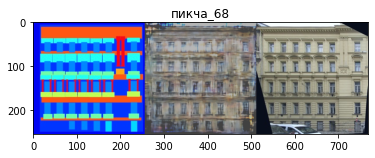

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


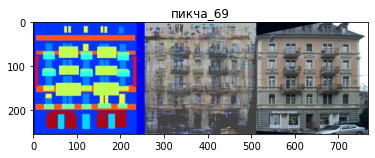

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


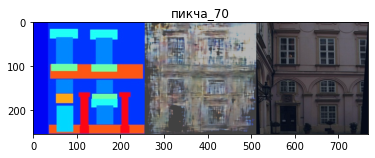

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


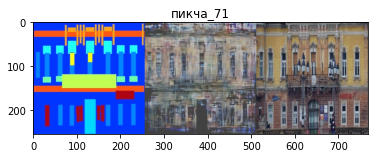

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


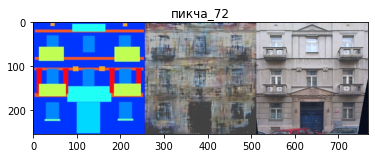

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


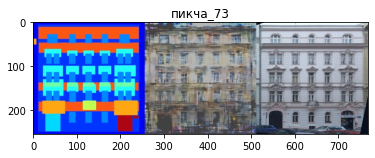

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


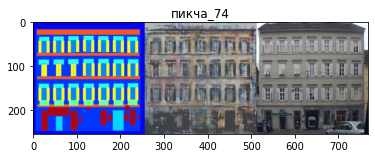

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


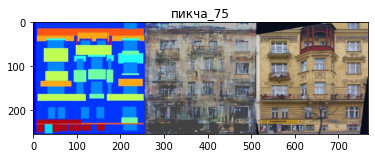

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


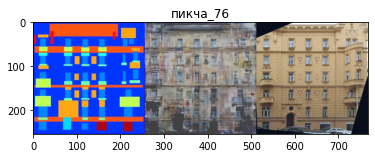

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


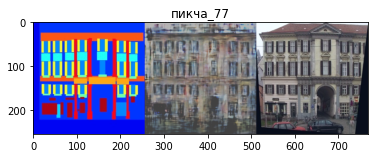

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


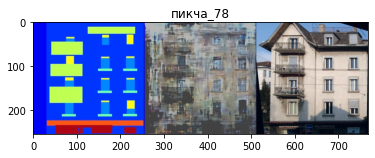

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


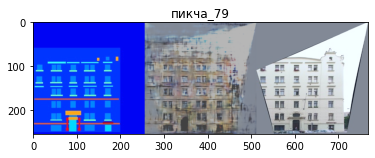

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


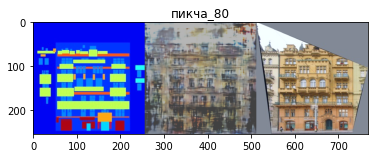

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


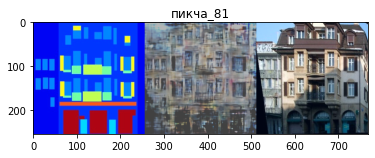

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


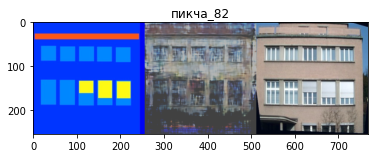

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


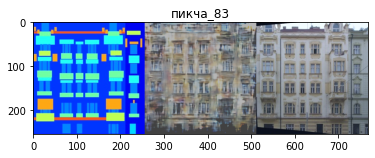

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


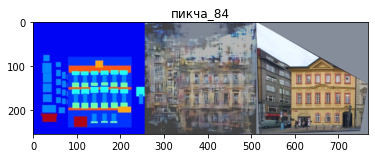

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


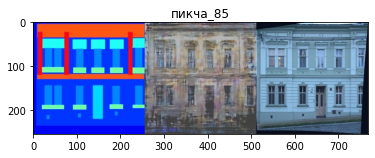

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


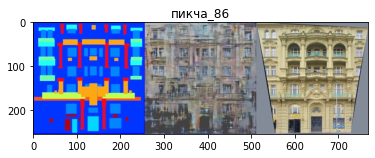

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


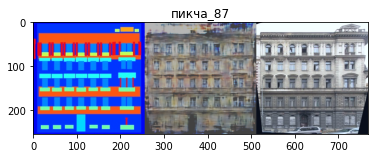

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


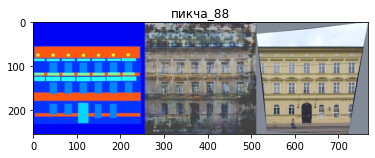

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


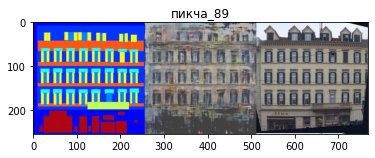

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


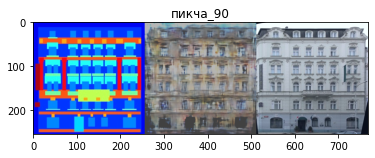

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


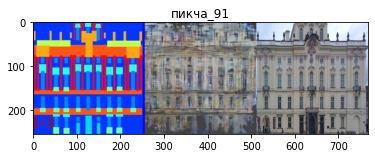

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


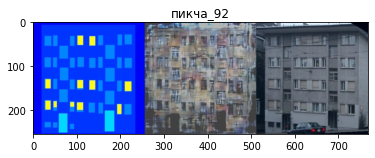

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


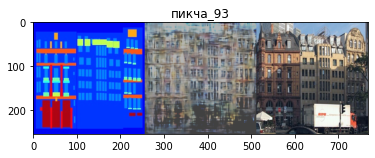

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


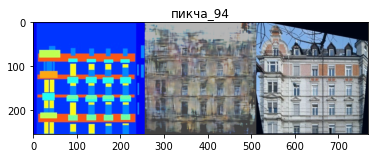

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


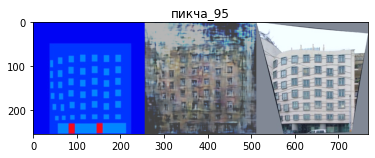

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


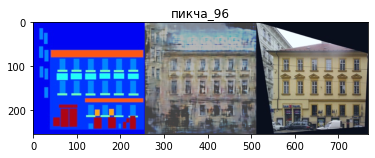

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


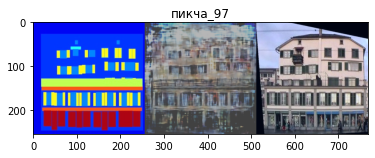

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


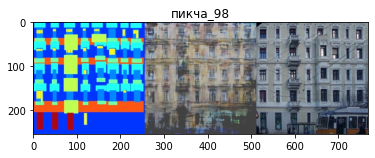

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


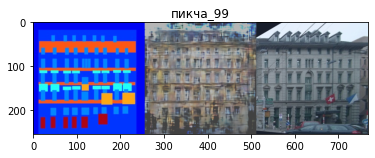

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

loader_val = data.DataLoader(data_set_val, batch_size=1, shuffle=False)
G.eval()
cnt = 0

for batch_1, batch_2 in loader_val:
  outlines = []
  target = []
  predict = []
  fake_2 = G(batch_1.cuda())
  outlines = unorm(batch_1)
  target = unorm(batch_2)
  predict = unorm(fake_2.cpu().detach())

  for i in range(predict.shape[0]):
      concat_image = (torch.cat([outlines[i], predict[i], target[i]], dim=-1))
      plt.title("пикча_" + str(cnt))
      plt.imshow(np.transpose(concat_image.detach().numpy(), (1,2,0)))
      plt.savefig('./res_pic_300/' + str(cnt) + '.png')
      cnt += 1
      plt.show()

In [ ]:
!mv ./res_pic_300 ./drive/MyDrive/gan_l1